<a href="https://colab.research.google.com/github/skimaza/jnu/blob/main/dog_breed_classification_jeju.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 제주대 딥러닝 특강 Day 2
# Convolutional Neural Network 실습 예제
# 전이학습을 이용한 견종 분류
- https://github.com/Ahmad-shaikh575/dog-breed-classifier 예제를 이용했음  
- 예제를 설명하는 글은 https://levelup.gitconnected.com/dog-breed-classifier-with-pytorch-using-transfer-learning-8f15af6f9010

# 실행전에 Colab 메뉴에서 런타임->런타임 유형변경을 선택하여 하드웨어 가속기가 GPU로 선택되었는지 확인
### GPU를 사용하지 않아도 실행할 수 있으나 학습에 시간이 오래 걸림

# 학습에 사용할 데이터셋 다운로드

- urllib 라이브러리의 request 모듈의 urlretrieve 함수를 이용 (https://docs.python.org/3/library/urllib.request.html)  
- 첫번째 인자는 URL, 두번째 인자는 저장할 파일명  
- (주의) urlretrieve를 사용할 때 두번째 인자를 지정하지 않으면 임시 디렉토리(/tmp)에 임의의 이름으로 저장됨.

In [9]:
import os
import urllib.request
urllib.request.urlretrieve('https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/dogImages.zip', 'dogImages.zip')

('dogImages.zip', <http.client.HTTPMessage at 0x7f809fa2c910>)

# 아래 코드는 다운로드가 안 되는 경우를 위한 코드
### 라인 앞의 '#'을 지우고 실행
- (주의) 이번 파일은 크기가 커서 MLP 예제와 다르게 wget 명령문에서 복잡한 처리를 해줘야 다운로드가 성공함
- 다운로드후 '!ls -l' 명령 결과 dogImages.zip 파일크기가 1132023110 바이트인지 꼭 확인


In [15]:
#!wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=1JQ-A69KBwYlS1yFNP2Yz2K5dwysgcxcB' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1JQ-A69KBwYlS1yFNP2Yz2K5dwysgcxcB" -O dogImages.zip && rm -rf /tmp/cookies.txt

--2021-08-23 23:03:55--  https://docs.google.com/uc?export=download&confirm=j9eY&id=1JQ-A69KBwYlS1yFNP2Yz2K5dwysgcxcB
Resolving docs.google.com (docs.google.com)... 173.194.76.101, 173.194.76.139, 173.194.76.100, ...
Connecting to docs.google.com (docs.google.com)|173.194.76.101|:443... connected.
HTTP request sent, awaiting response... 302 Moved Temporarily
Location: https://doc-10-0g-docs.googleusercontent.com/docs/securesc/jdg6pk7banm93g6t1t76qecje76crvo3/1mreq0ssnm5sm522fdu300m5ioues4c0/1629759825000/06514818370783056650/08282917584086734775Z/1JQ-A69KBwYlS1yFNP2Yz2K5dwysgcxcB?e=download [following]
--2021-08-23 23:03:55--  https://doc-10-0g-docs.googleusercontent.com/docs/securesc/jdg6pk7banm93g6t1t76qecje76crvo3/1mreq0ssnm5sm522fdu300m5ioues4c0/1629759825000/06514818370783056650/08282917584086734775Z/1JQ-A69KBwYlS1yFNP2Yz2K5dwysgcxcB?e=download
Resolving doc-10-0g-docs.googleusercontent.com (doc-10-0g-docs.googleusercontent.com)... 74.125.133.132, 2a00:1450:400c:c07::84
Connecting

dogImages.zip이 다운로드됐는지 확인

In [17]:
!ls -l

total 1105500
-rw-r--r-- 1 root root 1132023110 Aug 23 23:04 dogImages.zip
drwxr-xr-x 1 root root       4096 Aug 13 13:35 sample_data


압축 풀기

In [18]:
!unzip 'dogImages.zip'

스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
  inflating: dogImages/train/048.Chihuahua/Chihuahua_03417.jpg  
  inflating: dogImages/train/048.Chihuahua/Chihuahua_03418.jpg  
  inflating: dogImages/train/048.Chihuahua/Chihuahua_03421.jpg  
  inflating: dogImages/train/048.Chihuahua/Chihuahua_03423.jpg  
  inflating: dogImages/train/048.Chihuahua/Chihuahua_03424.jpg  
  inflating: dogImages/train/048.Chihuahua/Chihuahua_03425.jpg  
  inflating: dogImages/train/048.Chihuahua/Chihuahua_03426.jpg  
  inflating: dogImages/train/048.Chihuahua/Chihuahua_03428.jpg  
  inflating: dogImages/train/048.Chihuahua/Chihuahua_03429.jpg  
  inflating: dogImages/train/048.Chihuahua/Chihuahua_03430.jpg  
  inflating: dogImages/train/048.Chihuahua/Chihuahua_03431.jpg  
  inflating: dogImages/train/048.Chihuahua/Chihuahua_03432.jpg  
  inflating: dogImages/train/048.Chihuahua/Chihuahua_03433.jpg  
  inflating: dogImages/train/048.Chihuahua/Chihuahua_03434.jpg  
  inflating: dogImages/train/048.Chihuahua/Chihuahua_0

### 다운받은 데이터 살펴보기

In [19]:
!ls dogImages

test  train  valid


이미 train, valid, test 데이터셋이 구분되어 있음

In [20]:
!ls dogImages/train

001.Affenpinscher		    068.Flat-coated_retriever
002.Afghan_hound		    069.French_bulldog
003.Airedale_terrier		    070.German_pinscher
004.Akita			    071.German_shepherd_dog
005.Alaskan_malamute		    072.German_shorthaired_pointer
006.American_eskimo_dog		    073.German_wirehaired_pointer
007.American_foxhound		    074.Giant_schnauzer
008.American_staffordshire_terrier  075.Glen_of_imaal_terrier
009.American_water_spaniel	    076.Golden_retriever
010.Anatolian_shepherd_dog	    077.Gordon_setter
011.Australian_cattle_dog	    078.Great_dane
012.Australian_shepherd		    079.Great_pyrenees
013.Australian_terrier		    080.Greater_swiss_mountain_dog
014.Basenji			    081.Greyhound
015.Basset_hound		    082.Havanese
016.Beagle			    083.Ibizan_hound
017.Bearded_collie		    084.Icelandic_sheepdog
018.Beauceron			    085.Irish_red_and_white_setter
019.Bedlington_terrier		    086.Irish_setter
020.Belgian_malinois		    087.Irish_terrier
021.Belgian_sheepdog		    088.Irish_water_spaniel
022.Belg

### 133 종류의 개 이미지가 디렉토리별로 저장되어 있다

In [21]:
!ls dogImages/train/001.Affenpinscher/

Affenpinscher_00001.jpg  Affenpinscher_00025.jpg  Affenpinscher_00056.jpg
Affenpinscher_00002.jpg  Affenpinscher_00026.jpg  Affenpinscher_00057.jpg
Affenpinscher_00004.jpg  Affenpinscher_00027.jpg  Affenpinscher_00059.jpg
Affenpinscher_00005.jpg  Affenpinscher_00028.jpg  Affenpinscher_00060.jpg
Affenpinscher_00006.jpg  Affenpinscher_00029.jpg  Affenpinscher_00061.jpg
Affenpinscher_00007.jpg  Affenpinscher_00030.jpg  Affenpinscher_00062.jpg
Affenpinscher_00008.jpg  Affenpinscher_00031.jpg  Affenpinscher_00063.jpg
Affenpinscher_00009.jpg  Affenpinscher_00032.jpg  Affenpinscher_00064.jpg
Affenpinscher_00010.jpg  Affenpinscher_00033.jpg  Affenpinscher_00065.jpg
Affenpinscher_00011.jpg  Affenpinscher_00034.jpg  Affenpinscher_00066.jpg
Affenpinscher_00012.jpg  Affenpinscher_00035.jpg  Affenpinscher_00067.jpg
Affenpinscher_00013.jpg  Affenpinscher_00037.jpg  Affenpinscher_00069.jpg
Affenpinscher_00014.jpg  Affenpinscher_00039.jpg  Affenpinscher_00070.jpg
Affenpinscher_00015.jpg  Affenpinscher

In [22]:
!ls dogImages/train/133.Yorkshire_terrier/

Yorkshire_terrier_08314.jpg  Yorkshire_terrier_08331.jpg
Yorkshire_terrier_08315.jpg  Yorkshire_terrier_08332.jpg
Yorkshire_terrier_08316.jpg  Yorkshire_terrier_08335.jpg
Yorkshire_terrier_08317.jpg  Yorkshire_terrier_08338.jpg
Yorkshire_terrier_08318.jpg  Yorkshire_terrier_08339.jpg
Yorkshire_terrier_08319.jpg  Yorkshire_terrier_08340.jpg
Yorkshire_terrier_08320.jpg  Yorkshire_terrier_08341.jpg
Yorkshire_terrier_08321.jpg  Yorkshire_terrier_08342.jpg
Yorkshire_terrier_08322.jpg  Yorkshire_terrier_08343.jpg
Yorkshire_terrier_08323.jpg  Yorkshire_terrier_08344.jpg
Yorkshire_terrier_08324.jpg  Yorkshire_terrier_08345.jpg
Yorkshire_terrier_08327.jpg  Yorkshire_terrier_08347.jpg
Yorkshire_terrier_08328.jpg  Yorkshire_terrier_08349.jpg
Yorkshire_terrier_08329.jpg  Yorkshire_terrier_08350.jpg
Yorkshire_terrier_08330.jpg  Yorkshire_terrier_08351.jpg


In [23]:
!ls dogImages/valid/001.Affenpinscher/

Affenpinscher_00038.jpg  Affenpinscher_00042.jpg  Affenpinscher_00068.jpg
Affenpinscher_00040.jpg  Affenpinscher_00049.jpg  Affenpinscher_00074.jpg
Affenpinscher_00041.jpg  Affenpinscher_00055.jpg


In [24]:
!ls dogImages/test/001.Affenpinscher/

Affenpinscher_00003.jpg  Affenpinscher_00047.jpg  Affenpinscher_00071.jpg
Affenpinscher_00023.jpg  Affenpinscher_00048.jpg  Affenpinscher_00078.jpg
Affenpinscher_00036.jpg  Affenpinscher_00058.jpg


### 데이터셋을 본 후 간단한 요약
- 데이터는 train, valid, test 디렉토리로 구분되어 있음
- 각 디렉토리에는 133개 견종 디렉토리가 'ddd.breed' 형식으로 구성되어 있음
- 견종 디렉토리에는 'breed_ddddd.jpg' 형식의 이름을 갖는 jpg 이미지 파일들이 있음
- 견종 디렉토리에 있는 이미지의 개수는 견종별로 일치하지 않는 것 같음

### 전체 데이터에 대한 분포를 확인하여 위 요약을 검증

glob는 디렉토리에서 파일리스트를 읽어오는 라이브러리  
읽어온 결과의 순서는 이름순이 아님

In [25]:
import numpy as np
from glob import glob

In [26]:
datadir = 'dogImages'
train_breed_dirs = glob(datadir + '/train/*')
valid_breed_dirs = glob(datadir + '/valid/*')
test_breed_dirs = glob(datadir + '/test/*')

학습데이터셋 크기와 처음 10가지 종류 보기

In [27]:
print(len(train_breed_dirs))
print(train_breed_dirs[:10])

(133,
 ['dogImages/train/024.Bichon_frise',
  'dogImages/train/130.Welsh_springer_spaniel',
  'dogImages/train/037.Brittany',
  'dogImages/train/131.Wirehaired_pointing_griffon',
  'dogImages/train/022.Belgian_tervuren',
  'dogImages/train/017.Bearded_collie',
  'dogImages/train/016.Beagle',
  'dogImages/train/030.Border_terrier',
  'dogImages/train/125.Portuguese_water_dog',
  'dogImages/train/084.Icelandic_sheepdog'])

In [ ]:
len(valid_breed_dirs), len(test_breed_dirs)

(133, 133)

순서가 섞여서 보기 어려움  
natsort 패키지를 이용해서 사람이 보는 방식으로 정렬

In [28]:
from natsort import natsorted

In [32]:
train_breed_dirs = natsorted(train_breed_dirs)
valid_breed_dirs = natsorted(valid_breed_dirs)
test_breed_dirs = natsorted(test_breed_dirs)
train_breed_dirs[:10]

['dogImages/train/001.Affenpinscher',
 'dogImages/train/002.Afghan_hound',
 'dogImages/train/003.Airedale_terrier',
 'dogImages/train/004.Akita',
 'dogImages/train/005.Alaskan_malamute',
 'dogImages/train/006.American_eskimo_dog',
 'dogImages/train/007.American_foxhound',
 'dogImages/train/008.American_staffordshire_terrier',
 'dogImages/train/009.American_water_spaniel',
 'dogImages/train/010.Anatolian_shepherd_dog']

정렬이 되었음

### train_breed_dirs 안에 있는 파일 개수 확인

plotting을 위해 names에 디렉토리, train_counts에 디렉토리의 이미지 개수를 저장

In [33]:
names = []
train_counts = []
for d in train_breed_dirs:
    breed_name = d.split('/')[-1]
    image_count = len(glob(d + '/*.jpg'))
    names.append(breed_name)
    train_counts.append(image_count)
    print("{:40}: {} images for train".format(breed_name, image_count))

001.Affenpinscher                       : 64 images for train
002.Afghan_hound                        : 58 images for train
003.Airedale_terrier                    : 52 images for train
004.Akita                               : 63 images for train
005.Alaskan_malamute                    : 77 images for train
006.American_eskimo_dog                 : 64 images for train
007.American_foxhound                   : 50 images for train
008.American_staffordshire_terrier      : 66 images for train
009.American_water_spaniel              : 34 images for train
010.Anatolian_shepherd_dog              : 50 images for train
011.Australian_cattle_dog               : 66 images for train
012.Australian_shepherd                 : 66 images for train
013.Australian_terrier                  : 46 images for train
014.Basenji                             : 69 images for train
015.Basset_hound                        : 73 images for train
016.Beagle                              : 59 images for train
017.Bear

names 제일 끝 3개의 요소와 데이터수 확인

In [34]:
names[-3:]

['131.Wirehaired_pointing_griffon',
 '132.Xoloitzcuintli',
 '133.Yorkshire_terrier']

In [35]:
train_counts[-3:]

[30, 26, 30]

# plotting을 위해 pyplot 임포트

In [36]:
from matplotlib import pyplot as plt

그림 크기를 크게 하도록 글로벌 설정을 변경

In [37]:
plt.rcParams['figure.figsize'] = (20, 10)

클래스별(디렉토리별)로 train data 개수를 플로팅

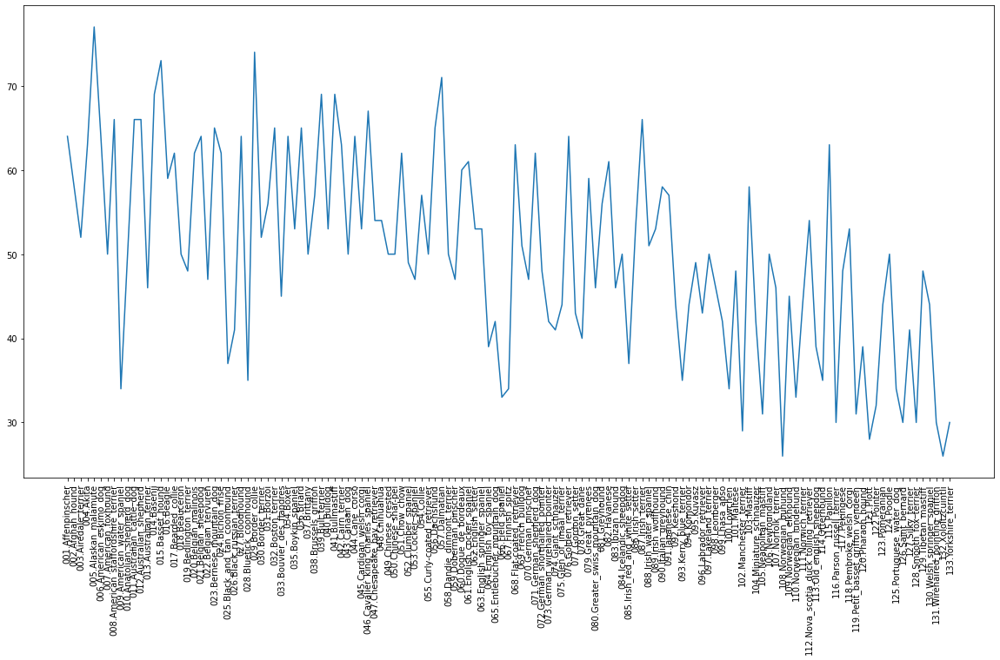

In [38]:
plt.plot(names, train_counts)
plt.xticks(rotation=90, fontsize=10);    # 여기에 세미콜론을 넣어서 주피터에서 xticks의 리턴값을 보여주지 않도록 지정했다. 

valid와 test data에 대해서 동일한 플로팅

In [39]:
valid_counts = []
for d in valid_breed_dirs:
    breed_name = d.split('/')[-1]
    image_count = len(glob(d + '/*.jpg'))
    # names.append(breed_name)  # names는 train에서 이미 구했으므로 여기서 다시 모을 필요없음
    valid_counts.append(image_count)
    print("{:40}: {} images for validation".format(breed_name, image_count))

001.Affenpinscher                       : 8 images for validation
002.Afghan_hound                        : 7 images for validation
003.Airedale_terrier                    : 7 images for validation
004.Akita                               : 8 images for validation
005.Alaskan_malamute                    : 9 images for validation
006.American_eskimo_dog                 : 8 images for validation
007.American_foxhound                   : 6 images for validation
008.American_staffordshire_terrier      : 8 images for validation
009.American_water_spaniel              : 4 images for validation
010.Anatolian_shepherd_dog              : 6 images for validation
011.Australian_cattle_dog               : 8 images for validation
012.Australian_shepherd                 : 8 images for validation
013.Australian_terrier                  : 6 images for validation
014.Basenji                             : 8 images for validation
015.Basset_hound                        : 9 images for validation
016.Beagle

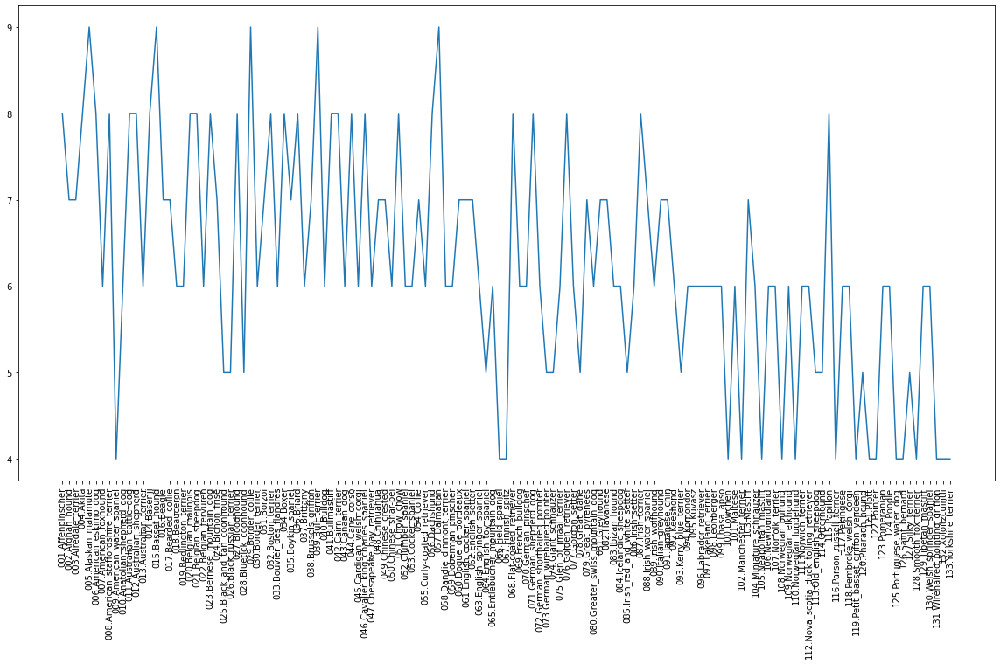

In [40]:
plt.plot(names, valid_counts)
plt.xticks(rotation=90, fontsize=10);

In [41]:
test_counts = []
for d in test_breed_dirs:
    breed_name = d.split('/')[-1]
    image_count = len(glob(d + '/*.jpg'))
    test_counts.append(image_count)
    print("{:40}: {} images for test".format(breed_name, image_count))

001.Affenpinscher                       : 8 images for test
002.Afghan_hound                        : 8 images for test
003.Airedale_terrier                    : 6 images for test
004.Akita                               : 8 images for test
005.Alaskan_malamute                    : 10 images for test
006.American_eskimo_dog                 : 8 images for test
007.American_foxhound                   : 7 images for test
008.American_staffordshire_terrier      : 8 images for test
009.American_water_spaniel              : 4 images for test
010.Anatolian_shepherd_dog              : 6 images for test
011.Australian_cattle_dog               : 9 images for test
012.Australian_shepherd                 : 9 images for test
013.Australian_terrier                  : 6 images for test
014.Basenji                             : 9 images for test
015.Basset_hound                        : 10 images for test
016.Beagle                              : 8 images for test
017.Bearded_collie                    

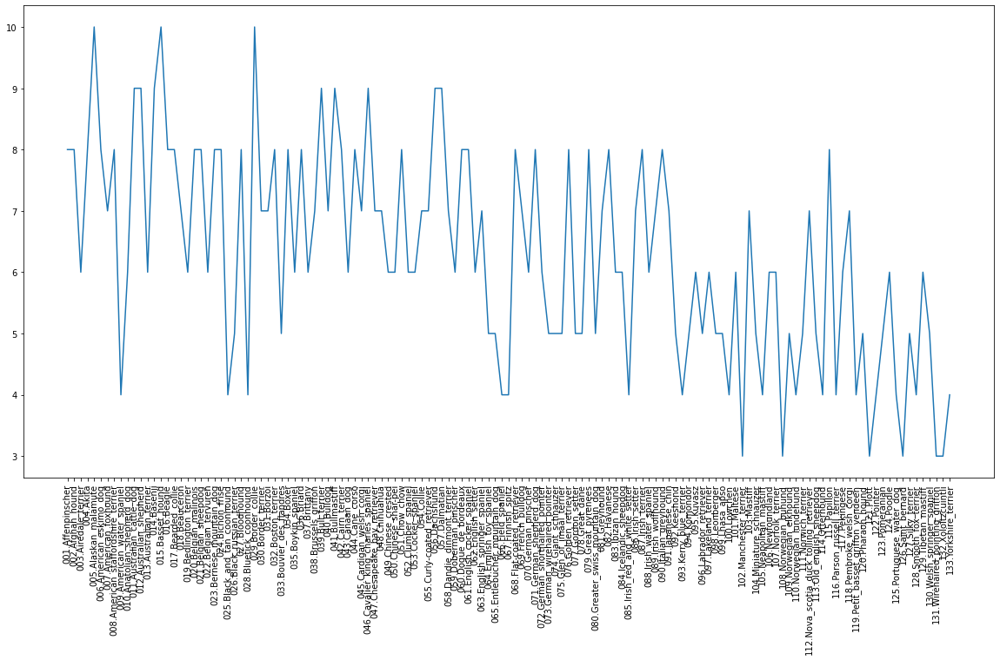

In [42]:
plt.plot(names, test_counts)
plt.xticks(rotation=90, fontsize=10);

train, valid, test count를 한꺼번에 플로팅하여 데이터수를 상대적으로 비교

pyplot은 한 셀에서는 plt.show()를 실행하거나 셀이 끝나기 전까지 같은 그래프에 그려준다.  
셀이 나눠지면 다른 그림이 나오게 되므로 아래 명령은 한 셀에서 실행해야 한다

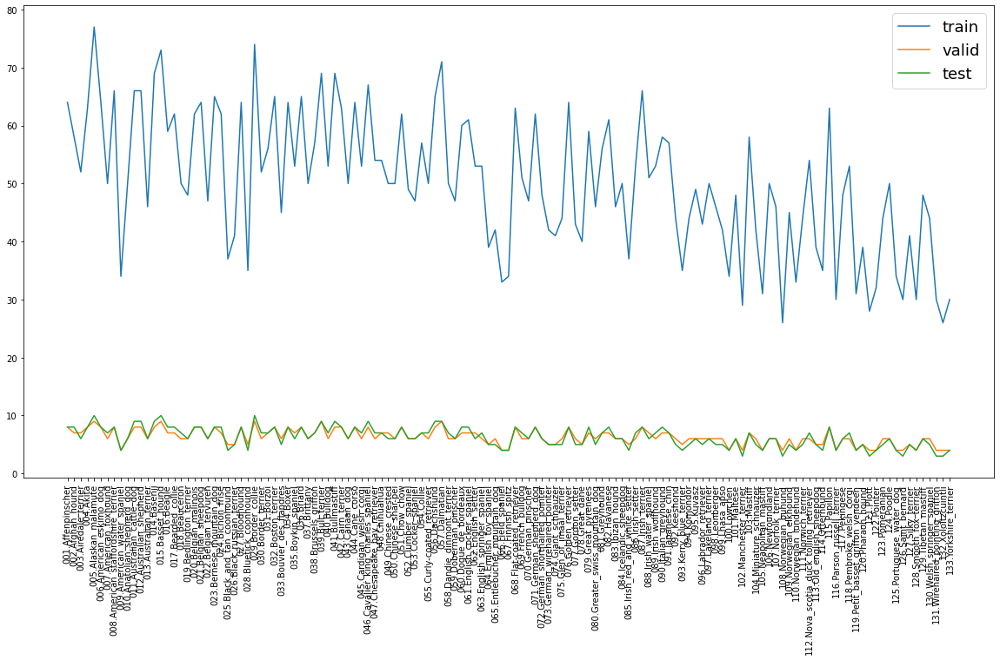

In [47]:
plt.plot(names, train_counts, label='train')
plt.plot(names, valid_counts, label='valid')
plt.plot(names, test_counts, label='test')
plt.legend(fontsize=18)
plt.xticks(rotation=90, fontsize=10)
plt.show() # 같은 셀에서 실행하고 있으므로 이 명령은 필요없다. 여러 데이터를 한 그래프에 표시하는 기능을 명확히 표시하기 위해 넣어두었음

train은 클래스당 35-75개, valid와 test는 클래스당 5-10개 수준임을 확인할 수 있다

# 이미지를 직접 확인하자

## PIL(Python Image Library)은 파이썬에서 이미지를 처리하는 라이브러리 중 하나

In [48]:
from PIL import Image

In [49]:
train_breed_dirs[0]

'dogImages/train/001.Affenpinscher'

In [52]:
glob(train_breed_dirs[0] + '*/*.jpg')[:10]

['dogImages/train/001.Affenpinscher/Affenpinscher_00043.jpg',
 'dogImages/train/001.Affenpinscher/Affenpinscher_00076.jpg',
 'dogImages/train/001.Affenpinscher/Affenpinscher_00030.jpg',
 'dogImages/train/001.Affenpinscher/Affenpinscher_00075.jpg',
 'dogImages/train/001.Affenpinscher/Affenpinscher_00009.jpg',
 'dogImages/train/001.Affenpinscher/Affenpinscher_00024.jpg',
 'dogImages/train/001.Affenpinscher/Affenpinscher_00013.jpg',
 'dogImages/train/001.Affenpinscher/Affenpinscher_00054.jpg',
 'dogImages/train/001.Affenpinscher/Affenpinscher_00017.jpg',
 'dogImages/train/001.Affenpinscher/Affenpinscher_00052.jpg']

train_breed_dirs의 첫번째 디렉토리(dogImages/train/001.Affenpinscher)에서 모든 .jpg 파일을 읽고 그 중 첫번째 파일을 읽어들인다

dogImages/train/001.Affenpinscher/Affenpinscher_00043.jpg


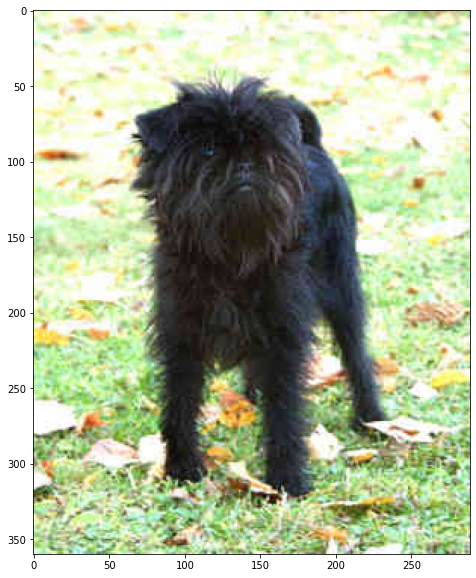

In [53]:
filename = glob(train_breed_dirs[0] + '/*.jpg')[0]
print(filename)
tr_affen_img = Image.open(filename)
plt.imshow(np.asarray(tr_affen_img));

### 두 종류에 대해서 이미지 보기

dogImages/train/001.Affenpinscher/Affenpinscher_00043.jpg
디렉토리 001.Affenpinscher


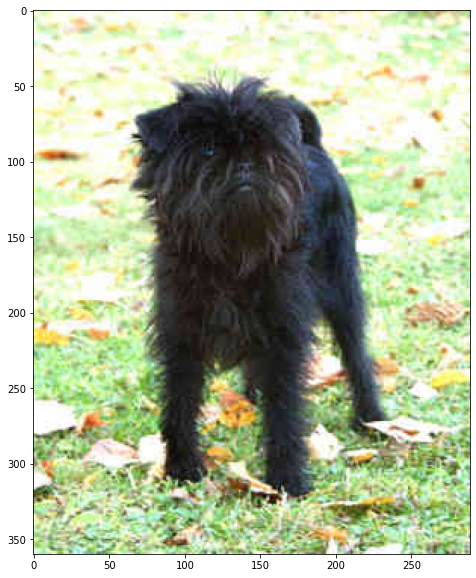

dogImages/train/002.Afghan_hound/Afghan_hound_00147.jpg
디렉토리 002.Afghan_hound


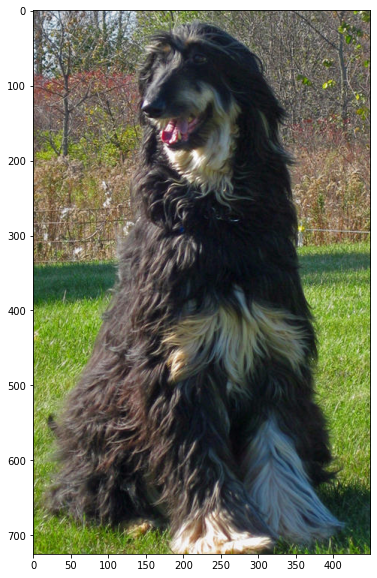

In [58]:
for d in train_breed_dirs[:2]:
    filename = glob(d + '/*.jpg')[0]
    img = Image.open(filename)
    plt.imshow(np.asarray(img))
    print(filename)
    print('디렉토리', d.split('/')[-1])
    plt.show(); # 그림을 여러개 그리기 때문에 매번 plt.show()를 해서 화면에 표시한다. 주피터 노트북 각 셀에서는 마지막에 자동으로 show를 처리해 주기 때문에 앞선 예제에서는 이 명령이 생략되었었다

## 여러 클래스 확인

계산에 사용할 파이썬 내장 나머지와 몫 연산 기능 확인  
파이썬 //(나눗셈 몫), %(나머지)

In [61]:
print('0/10의 몫과 나머지', 0 // 10, 0 % 10)
print('132/10의 몫과 나머지', 132 // 10, 132 % 10)
print('139/10의 나머지', 139//10)

0/10의 몫과 나머지 0 0
132/10의 몫과 나머지 13 2
139/10의 나머지 13


In [ ]:
# # 약간 복잡한 버전
# #fig, axes = plt.subplots(14, 10, figsize=(30, 100)) # subplots row index 0 to 13, column index 0 to 9
# fig, axes = plt.subplots(4, 10, figsize=(30,30))
# for ind, d in enumerate(train_breed_dirs[:40]):
#     breed_idx_name = d.split('/')[-1]
#     img = np.asarray(Image.open(glob(d + '/*.jpg')[0]))
#     row = ind // 10
#     col = ind % 10
#     #if ind < 133:
#     if ind < 35:
#         axes[row, col].imshow(img)
#         axes[row, col].set_title(breed_idx_name)
#     else:
#         axes[row, col].axis('off') # do not show at the ends
#         #axes[row, col].set_visible(False)
#         #axes[row, col].remove()
# plt.tight_layout()
# plt.show()
# plt.close(fig) # subplots의 fig를 close 하지 않으면 메모리가 반환되지 않는다.

40개만 그려보자

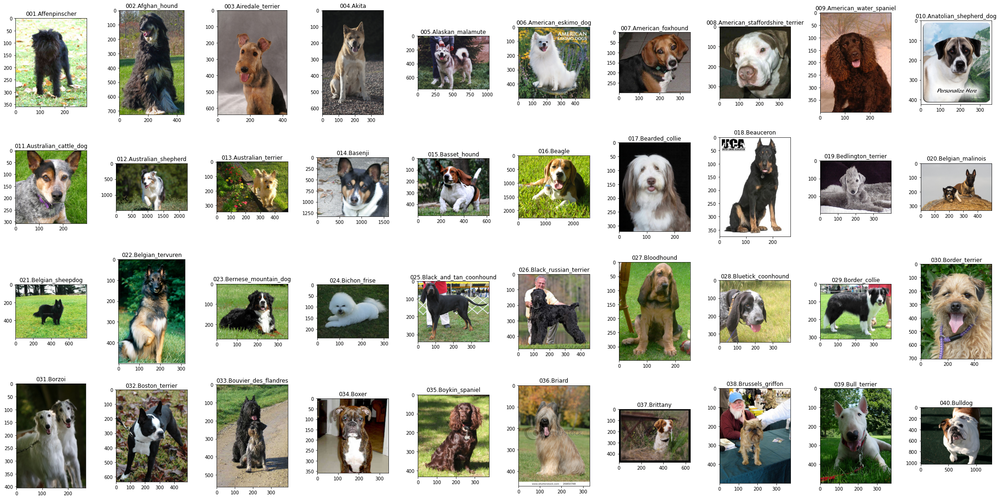

In [63]:
fig, axes = plt.subplots(4, 10, figsize=(30,15)) # 4 rows, 10 columns 형태로 여러 이미지 그리기
for ind, d in enumerate(train_breed_dirs[:40]):
    breed_idx_name = d.split('/')[-1]
    img = np.asarray(Image.open(glob(d + '/*.jpg')[0]))
    row = ind // 10 # 한 줄에 10개씩 그리기
    col = ind % 10 # 한 줄 안에서 순서
    axes[row, col].imshow(img)
    axes[row, col].set_title(breed_idx_name)
plt.tight_layout()
plt.show()
plt.close(fig) # subplots의 fig를 close 하지 않으면 메모리가 반환되지 않아서 가용메모리가 점차 줄어든다.

In [64]:

# load filenames for human and dog images
dog_files = np.array(glob("/content/dogImages/*/*/*"))
# print number of images in each dataset
print('There are %d total dog images.' % len(dog_files))

There are 8351 total dog images.


# Pretrained model download
전이학습을 위해 이미지넷으로 학습된 모델을 다운로드  
예제에서는 VGG11 CNN 모델을 사용

In [66]:
import torch
import torchvision.models as models

# define VGG11 model
VGG11 = models.vgg11(pretrained=True)

# check if CUDA is available
# Colab 시작할 때 런타임 유형을 GPU로 선택했으면 torch.cuda.is_available()가 True
use_cuda = torch.cuda.is_available()

# move model to GPU if CUDA is available
if use_cuda:
    VGG11 = VGG11.cuda()

Downloading: "https://download.pytorch.org/models/vgg11-8a719046.pth" to /root/.cache/torch/hub/checkpoints/vgg11-8a719046.pth


  0%|          | 0.00/507M [00:00<?, ?B/s]

In [67]:
use_cuda

True

VGG11은 2차원 CONV 8개, Fully Connected 3개로 구성된 11 레이어 CNN 모델  
레이어의 채널수
- Conv 레이어 3(입력 RGB 3ch)-64-128-256-256-512-512-512-512 Conv
- FC 레이어 4096-4096-1000(출력 1000 클래스) FC 레이어


- 3,4번 Conv, 5,6번 Conv, 7,8번 Conv 사이에는 MaxPooling을 하지 않아서 feature map 크기가 유지되고 있음.

In [69]:
VGG11

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (11): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (12): ReLU(inplace=True)
    (13): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (14): ReLU(inplace=True)
    (15): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
 

마지막 classifier 변수에 두 개의 fully connected layer와 output layer가 있다.  
output layer는 classifier[6] 이다.

# 데이터 로더 구성

In [71]:
from torchvision import datasets
from PIL import Image
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True
import torchvision.transforms as transforms


In [ ]:
data_dir = '/content/dogImages'
train_dir = data_dir + '/train'
valid_dir = data_dir + '/valid'
test_dir = data_dir + '/test'

## 이번에는 단순히 ToTensor뿐 아니라 이미지에 대해 rotation, resizeCrop, HorizontalFlip, Normalize까지 적용하여 data augmentation 한 후에 학습 진행
### 이미지 데이터 augmentation 결과 보기

torch.Size([3, 224, 224]) tensor(127)


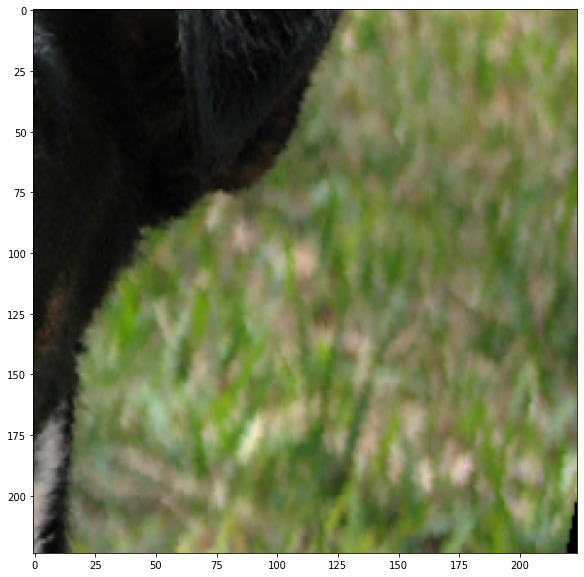

torch.Size([3, 224, 224]) tensor(3)


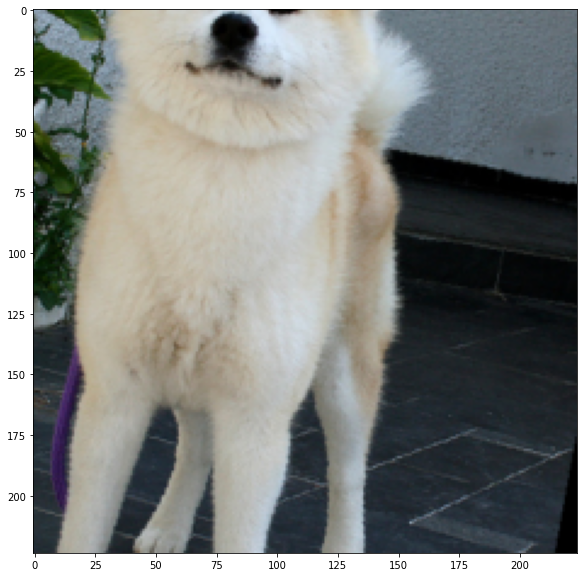

torch.Size([3, 224, 224]) tensor(128)


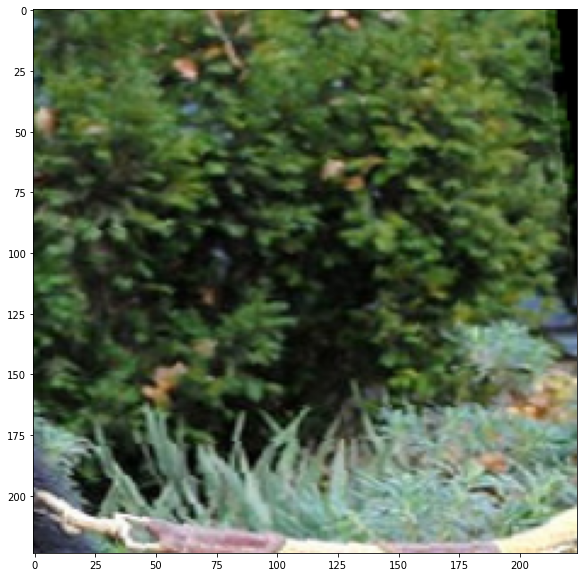

torch.Size([3, 224, 224]) tensor(42)


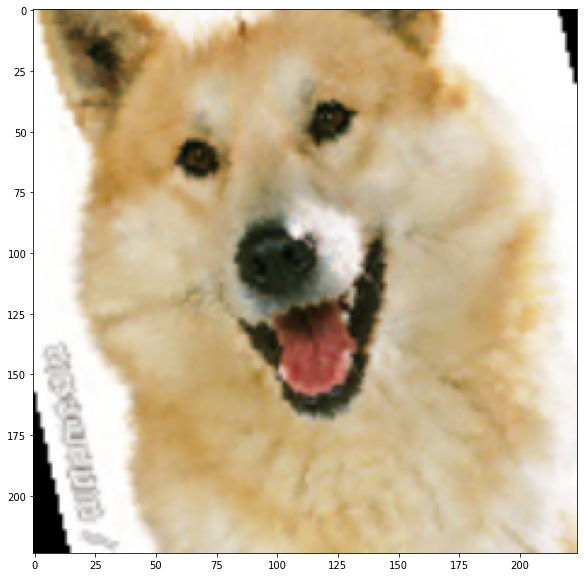

torch.Size([3, 224, 224]) tensor(50)


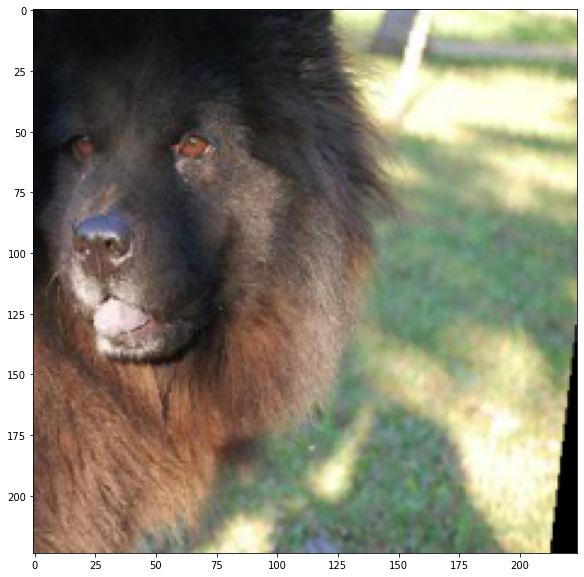

torch.Size([3, 224, 224]) tensor(0)


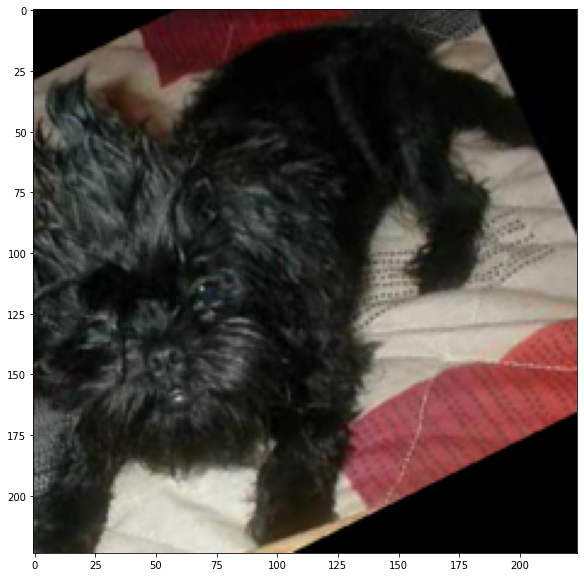

torch.Size([3, 224, 224]) tensor(123)


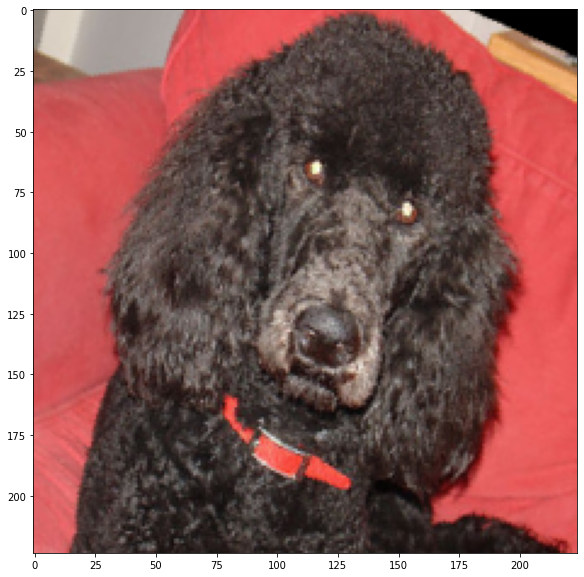

torch.Size([3, 224, 224]) tensor(34)


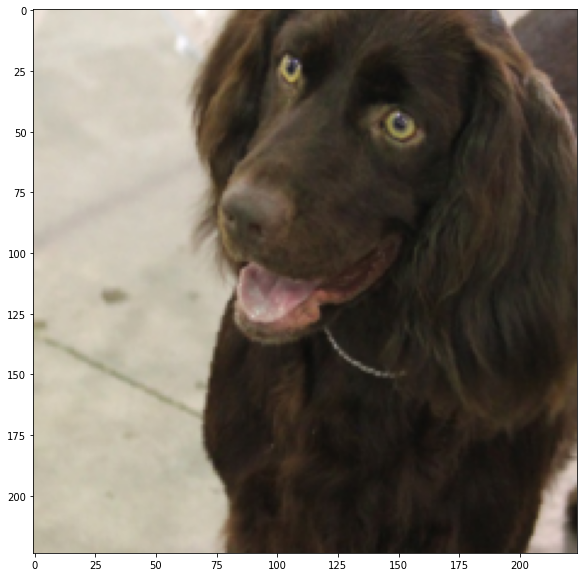

torch.Size([3, 224, 224]) tensor(32)


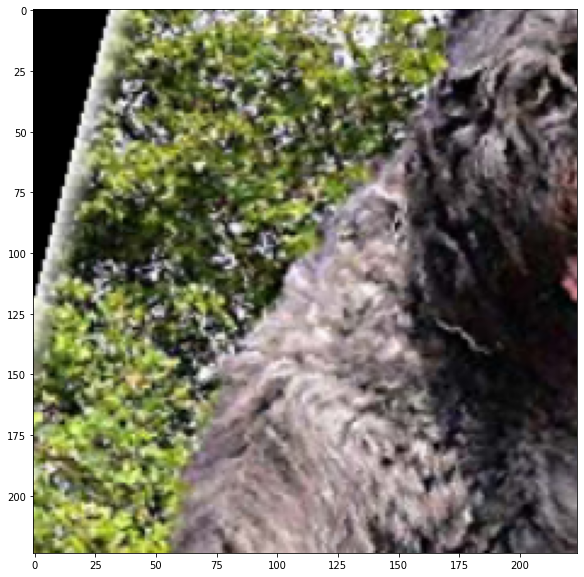

torch.Size([3, 224, 224]) tensor(117)


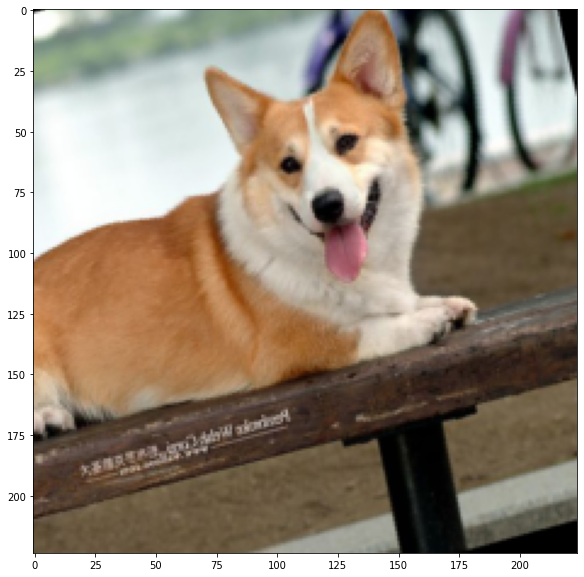

torch.Size([3, 224, 224]) tensor(61)


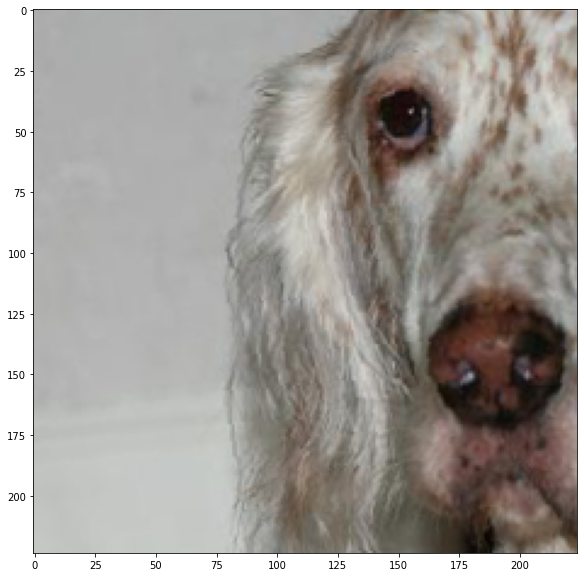

torch.Size([3, 224, 224]) tensor(71)


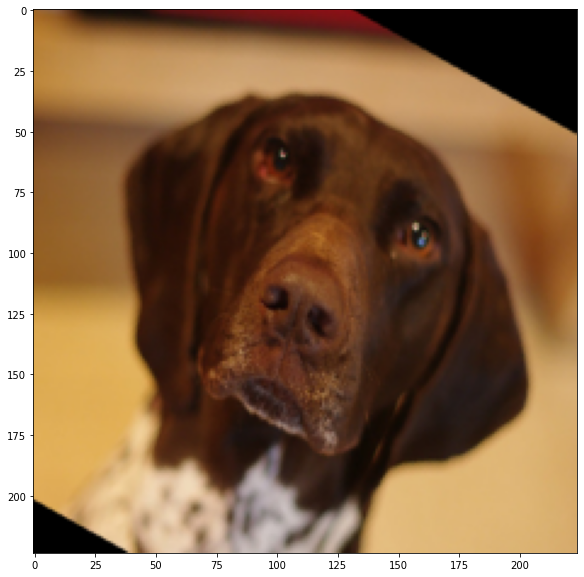

torch.Size([3, 224, 224]) tensor(37)


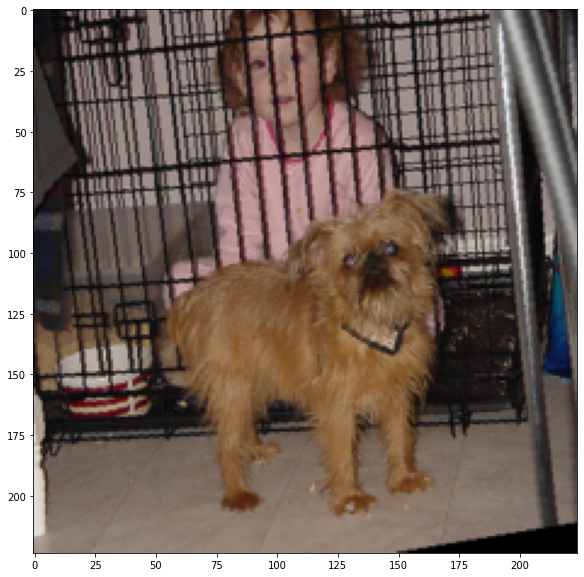

torch.Size([3, 224, 224]) tensor(28)


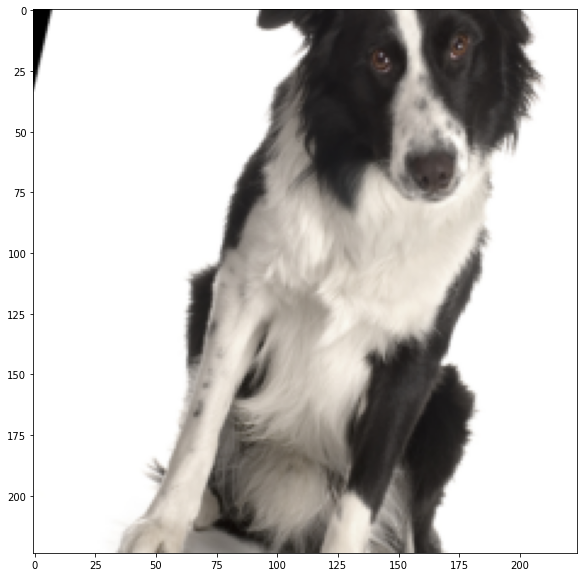

torch.Size([3, 224, 224]) tensor(35)


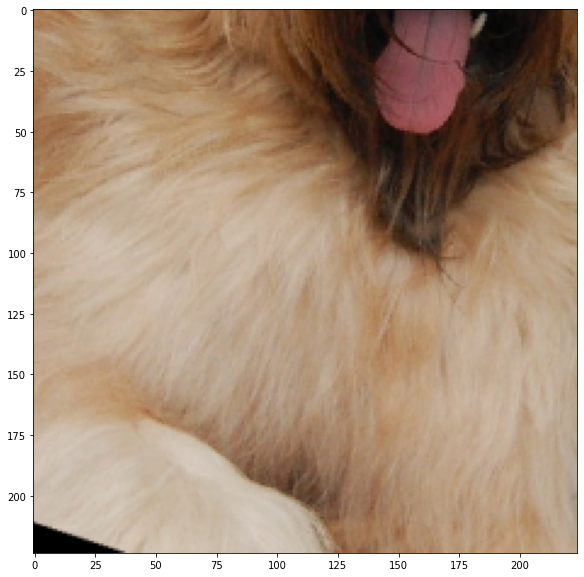

torch.Size([3, 224, 224]) tensor(30)


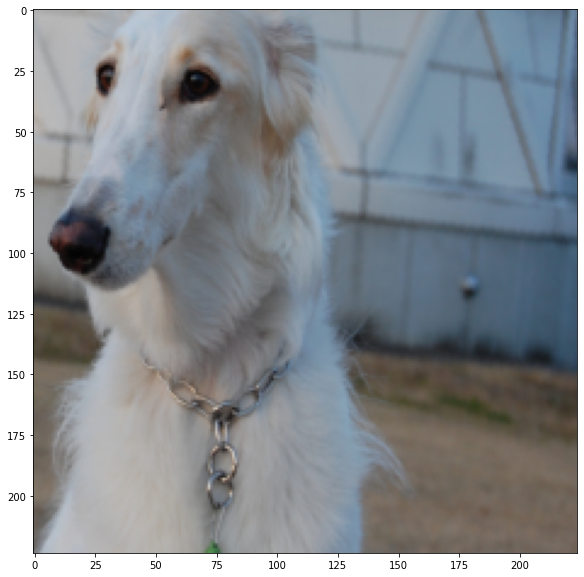

torch.Size([3, 224, 224]) tensor(116)


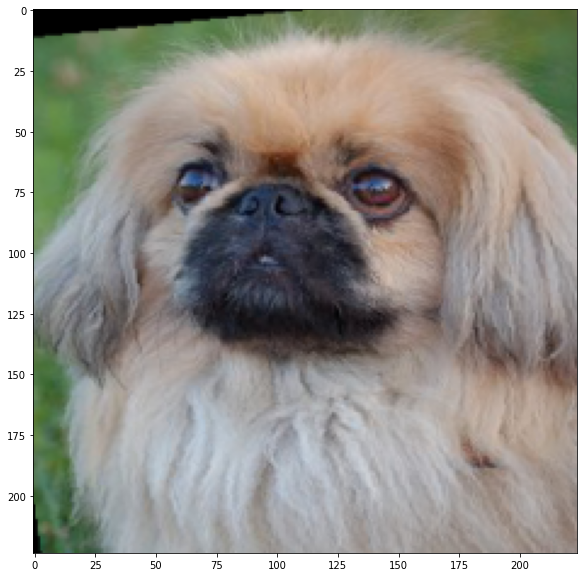

torch.Size([3, 224, 224]) tensor(31)


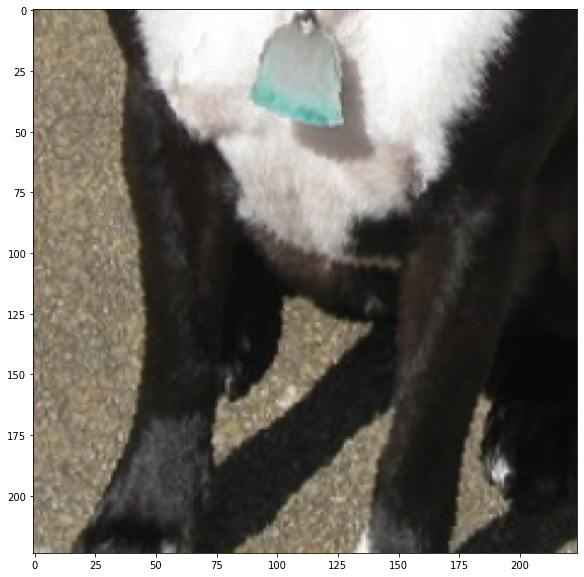

torch.Size([3, 224, 224]) tensor(116)


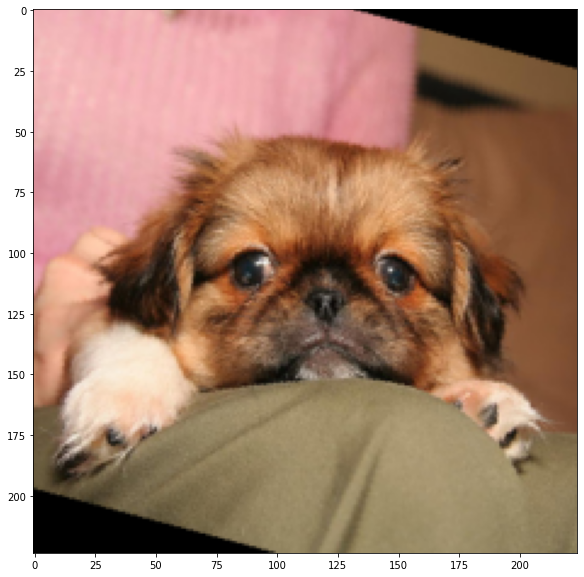

torch.Size([3, 224, 224]) tensor(50)


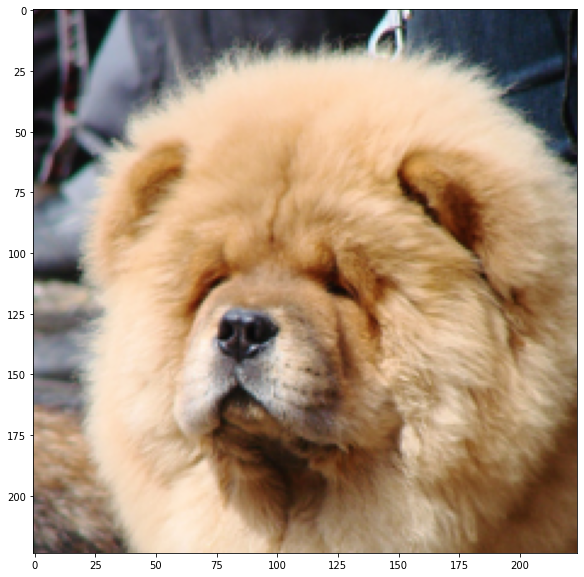

In [109]:
data_augmentation_transforms = transforms.Compose([transforms.RandomRotation(30),
                                                    transforms.RandomResizedCrop(224),
                                                    transforms.RandomHorizontalFlip(),
                                                    transforms.ToTensor(),
                                                    #transforms.Normalize([0.485, 0.456, 0.406], 
                                                    #                     [0.229, 0.224, 0.225])
                                                    ])
augmented_data = datasets.ImageFolder(train_dir, transform=data_augmentation_transforms)
augdata_loader = torch.utils.data.DataLoader(augmented_data, batch_size=20, shuffle=True)

# 미니배치 하나에 대해 augmented data 보기
for b, l in augdata_loader:
    for i in range(len(b)):
        print(b[i].shape, l[i])
        img = b[i].numpy() # tensor를 numpy array로 변환
        img = np.transpose(img, (1, 2, 0)) # color 채널 순서 맞춰주기
        plt.imshow(img)
        plt.show()
    break

## 전체 데이터로더 구성
데이터 augmentation에 데이터 값의 정규화까지 적용.  
이미지넷 데이터셋의 정규화 파라미터 적용: [0.485, 0.456, 0.406], [0.229, 0.224, 0.225]

In [110]:
data_dir = '/content/dogImages'
train_dir = data_dir + '/train'
valid_dir = data_dir + '/valid'
test_dir = data_dir + '/test'

train_transforms = transforms.Compose([transforms.RandomRotation(30),
                                       transforms.RandomResizedCrop(224),
                                       transforms.RandomHorizontalFlip(),
                                       transforms.ToTensor(),
                                       transforms.Normalize([0.485, 0.456, 0.406], 
                                                            [0.229, 0.224, 0.225])
                                       ])


valid_transforms = transforms.Compose([transforms.Resize(256),
                                       transforms.CenterCrop(224),
                                       transforms.ToTensor(),
                                       transforms.Normalize([0.485, 0.456, 0.406], 
                                                            [0.229, 0.224, 0.225])])

test_transforms = transforms.Compose([transforms.Resize(255),
                               transforms.CenterCrop(224),
                               transforms.ToTensor(),
                                       transforms.Normalize([0.485, 0.456, 0.406], 
                                                            [0.229, 0.224, 0.225])])
# TODO: Load the datasets with ImageFolder
train_data = datasets.ImageFolder(train_dir, transform=train_transforms)
valid_data = datasets.ImageFolder(valid_dir,transform=valid_transforms)
test_data = datasets.ImageFolder(test_dir, transform=test_transforms)

# TODO: Using the image datasets and the trainforms, define the dataloaders
trainloader = torch.utils.data.DataLoader(train_data, batch_size=20, shuffle=True)
testloader = torch.utils.data.DataLoader(test_data, batch_size=20,shuffle=False)
validloader = torch.utils.data.DataLoader(valid_data, batch_size=20,shuffle=False)
loaders_transfer = {'train':trainloader,
                  'valid':validloader,
                  'test':testloader}
data_transfer = {
    'train':trainloader
}

# vgg11 모델

In [111]:
import torchvision.models as models
import torch.nn as nn
model_transfer = models.vgg11(pretrained=True)

for param in model_transfer.parameters():
    param.requires_grad = False

if use_cuda:
    model_transfer = model_transfer.cuda()
print(model_transfer)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (11): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (12): ReLU(inplace=True)
    (13): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (14): ReLU(inplace=True)
    (15): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
 

pretrained model의 모든 weight를 고정했음  
마지막 출력 레이어만 새로 정의하여 학습

In [113]:
model_transfer.classifier[3].weight.requires_grad

False

In [114]:
model_transfer.classifier[6], model_transfer.classifier[6].weight.requires_grad

(Linear(in_features=4096, out_features=1000, bias=True), False)

# 출력 레이어가 이미지넷에 맞춰 1000개의 클래스로 되어 있다.
# 이 구조를 자신의 문제에 맞춰 바꿔 준다.
# dog breed가 133 종류이니 133개의 출력 레이어로 바꾼다

In [115]:
model_transfer.classifier[6] = nn.Linear(4096,133,bias=True)

In [116]:
model_transfer

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (11): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (12): ReLU(inplace=True)
    (13): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (14): ReLU(inplace=True)
    (15): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
 

새로 정의한 레이어는 디폴트로 requires_grad가 True임. 즉 학습할 수 있는 레이어

In [117]:
model_transfer.classifier[6], model_transfer.classifier[6].weight.requires_grad

(Linear(in_features=4096, out_features=133, bias=True), True)

Loss 함수와 Optimizer 정의

In [118]:
import torch.optim as optim

criterion_transfer = nn.CrossEntropyLoss()
optimizer_transfer = optim.SGD(model_transfer.parameters(), lr=0.001, momentum=0.9)

In [119]:
def train(n_epochs, loaders, model, optimizer, criterion, use_cuda, save_path):
    """returns trained model"""
    # initialize tracker for minimum validation loss
    valid_loss_min = np.inf 
    
    for epoch in range(1, n_epochs+1):
        # initialize variables to monitor training and validation loss
        train_loss = 0.0
        valid_loss = 0.0
        ###################
        # train the model #
        ###################
        model.train()
        for batch_idx, (data, target) in enumerate(loaders['train']):
            # move to GPU
            if use_cuda:
                data, target = data.cuda(), target.cuda()
                model.to('cuda')
            ## find the loss and update the model parameters accordingly
            ## record the average training loss, using something like

            ## train_loss = train_loss + ((1 / (batch_idx + 1)) * (loss.data - train_loss))
            optimizer.zero_grad()
            output = model(data)
            loss = criterion(output,target)
            loss.backward()
            optimizer.step()
            train_loss = train_loss + ((1 / (batch_idx + 1)) * (loss.data - train_loss))
        ######################    
        # validate the model #
        ######################
        model.eval()
        for batch_idx, (data, target) in enumerate(loaders['valid']):
            accuracy=0
            # move to GPU
            if use_cuda:
                data, target = data.cuda(), target.cuda()
            ## update the average validation loss
            logps = model(data)
            loss = criterion(logps, target)

            valid_loss += ((1 / (batch_idx + 1)) * (loss.data - valid_loss))
            
            
            
        # print training/validation statistics 
        print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
            epoch, 
            train_loss,
            valid_loss
            ))
        
        ## TODO: save the model if validation loss has decreased
        if valid_loss <= valid_loss_min:
            print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
            valid_loss_min,
            valid_loss))
            torch.save(model.state_dict(), 'model_transfer.pt')
            valid_loss_min = valid_loss
    # return trained model
    return model


## 10 epoch 학습

In [120]:
# train the model
model_transfer = train(10, loaders_transfer, model_transfer, optimizer_transfer, criterion_transfer, use_cuda, 'model_transfer.pt')

# load the model that got the best validation accuracy (uncomment the line below)
model_transfer.load_state_dict(torch.load('model_transfer.pt'))

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


Epoch: 1 	Training Loss: 2.695843 	Validation Loss: 0.968699
Validation loss decreased (inf --> 0.968699).  Saving model ...
Epoch: 2 	Training Loss: 1.544255 	Validation Loss: 0.707881
Validation loss decreased (0.968699 --> 0.707881).  Saving model ...
Epoch: 3 	Training Loss: 1.314571 	Validation Loss: 0.615814
Validation loss decreased (0.707881 --> 0.615814).  Saving model ...
Epoch: 4 	Training Loss: 1.237420 	Validation Loss: 0.555732
Validation loss decreased (0.615814 --> 0.555732).  Saving model ...
Epoch: 5 	Training Loss: 1.145796 	Validation Loss: 0.515711
Validation loss decreased (0.555732 --> 0.515711).  Saving model ...
Epoch: 6 	Training Loss: 1.144577 	Validation Loss: 0.491315
Validation loss decreased (0.515711 --> 0.491315).  Saving model ...
Epoch: 7 	Training Loss: 1.091141 	Validation Loss: 0.484367
Validation loss decreased (0.491315 --> 0.484367).  Saving model ...
Epoch: 8 	Training Loss: 1.056579 	Validation Loss: 0.490994
Epoch: 9 	Training Loss: 1.055769 

<All keys matched successfully>

In [121]:
def test(loaders, model, criterion, use_cuda):

    # monitor test loss and accuracy
    test_loss = 0.
    correct = 0.
    total = 0.

    model.eval()
    for batch_idx, (data, target) in enumerate(loaders['test']):
        # move to GPU
        if use_cuda:
            data, target = data.cuda(), target.cuda()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = model(data)
        # calculate the loss
        loss = criterion(output, target)
        # update average test loss 
        test_loss = test_loss + ((1 / (batch_idx + 1)) * (loss.data - test_loss))
        # convert output probabilities to predicted class
        pred = output.data.max(1, keepdim=True)[1]
        # compare predictions to true label
        correct += np.sum(np.squeeze(pred.eq(target.data.view_as(pred))).cpu().numpy())
        total += data.size(0)
            
    print('Test Loss: {:.6f}\n'.format(test_loss))

    print('\nTest Accuracy: %2d%% (%2d/%2d)' % (
        100. * correct / total, correct, total))
test(loaders_transfer, model_transfer, criterion_transfer, use_cuda)

Test Loss: 0.489296


Test Accuracy: 84% (709/836)


In [122]:
!ls dogImages/test

001.Affenpinscher		    068.Flat-coated_retriever
002.Afghan_hound		    069.French_bulldog
003.Airedale_terrier		    070.German_pinscher
004.Akita			    071.German_shepherd_dog
005.Alaskan_malamute		    072.German_shorthaired_pointer
006.American_eskimo_dog		    073.German_wirehaired_pointer
007.American_foxhound		    074.Giant_schnauzer
008.American_staffordshire_terrier  075.Glen_of_imaal_terrier
009.American_water_spaniel	    076.Golden_retriever
010.Anatolian_shepherd_dog	    077.Gordon_setter
011.Australian_cattle_dog	    078.Great_dane
012.Australian_shepherd		    079.Great_pyrenees
013.Australian_terrier		    080.Greater_swiss_mountain_dog
014.Basenji			    081.Greyhound
015.Basset_hound		    082.Havanese
016.Beagle			    083.Ibizan_hound
017.Bearded_collie		    084.Icelandic_sheepdog
018.Beauceron			    085.Irish_red_and_white_setter
019.Bedlington_terrier		    086.Irish_setter
020.Belgian_malinois		    087.Irish_terrier
021.Belgian_sheepdog		    088.Irish_water_spaniel
022.Belg

In [123]:
!mkdir my_dogs

In [124]:
!cp dogImages/test/*/*.jpg my_dogs

In [125]:
!ls my_dogs

Affenpinscher_00003.jpg
Affenpinscher_00023.jpg
Affenpinscher_00036.jpg
Affenpinscher_00047.jpg
Affenpinscher_00048.jpg
Affenpinscher_00058.jpg
Affenpinscher_00071.jpg
Affenpinscher_00078.jpg
Afghan_hound_00116.jpg
Afghan_hound_00125.jpg
Afghan_hound_00139.jpg
Afghan_hound_00141.jpg
Afghan_hound_00143.jpg
Afghan_hound_00146.jpg
Afghan_hound_00149.jpg
Afghan_hound_00151.jpg
Airedale_terrier_00166.jpg
Airedale_terrier_00175.jpg
Airedale_terrier_00179.jpg
Airedale_terrier_00207.jpg
Airedale_terrier_00210.jpg
Airedale_terrier_00214.jpg
Akita_00244.jpg
Akita_00258.jpg
Akita_00262.jpg
Akita_00263.jpg
Akita_00270.jpg
Akita_00276.jpg
Akita_00282.jpg
Akita_00296.jpg
Alaskan_malamute_00309.jpg
Alaskan_malamute_00330.jpg
Alaskan_malamute_00346.jpg
Alaskan_malamute_00354.jpg
Alaskan_malamute_00360.jpg
Alaskan_malamute_00362.jpg
Alaskan_malamute_00375.jpg
Alaskan_malamute_00383.jpg
Alaskan_malamute_00386.jpg
Alaskan_malamute_00387.jpg
American_eskimo_dog_00406.jpg
American_eskimo_dog_00407.jpg
Amer

In [126]:
dog_files_short = np.array(glob("/content/my_dogs/*"))
# list of class names by index, i.e. a name can be accessed like class_names[0]
class_names = [item[4:].replace("_", " ") for item in data_transfer['train'].dataset.classes]

model_transfer.load_state_dict(torch.load('model_transfer.pt'))
def predict_breed_transfer(img_path):
    # load the image and return the predicted breed
    
    transform = transforms.Compose([transforms.Resize(255),
                               transforms.CenterCrop(224),
                               transforms.ToTensor(),
                                       transforms.Normalize([0.485, 0.456, 0.406], 
                                                            [0.229, 0.224, 0.225])])
    img = Image.open(img_path)
    img = transform(img)[:3,:,:].unsqueeze(0)
    if use_cuda:
        img = img.cuda()
        model_transfer.to('cuda')
        # forward pass: compute predicted outputs by passing inputs to the model
    model_transfer.eval()
    idx = torch.argmax(model_transfer(img))
    return class_names[idx]


    output = model_transfer(img)
    # convert output probabilities to predicted class
    pred = output.data.max(1, keepdim=True)[1]
    # compare predictions to true label
    return pred


In [127]:
plt.rcParams['figure.figsize'] = (5, 5)

In [128]:
len(dog_files_short)

836

Ground truth Anatolian shepherd dog


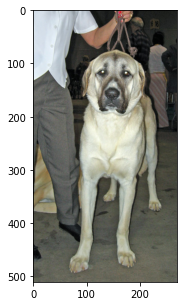

Prediction Mastiff
MISSED

Ground truth English cocker spaniel


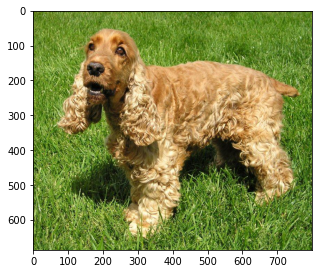

Prediction English cocker spaniel
CORRECT

Ground truth Canaan dog


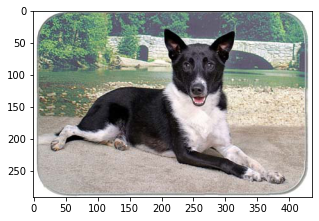

Prediction Canaan dog
CORRECT

Ground truth English cocker spaniel


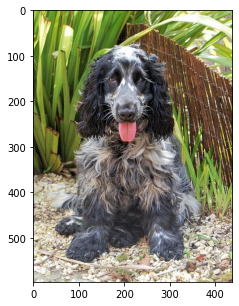

Prediction English cocker spaniel
CORRECT

Ground truth Black russian terrier


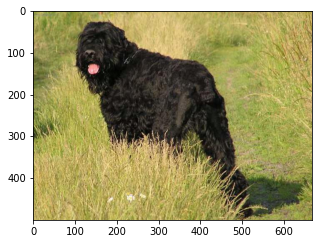

Prediction Black russian terrier
CORRECT

Ground truth Kuvasz


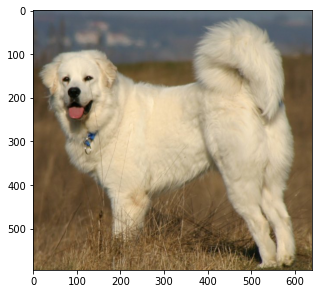

Prediction Kuvasz
CORRECT

Ground truth Norwich terrier


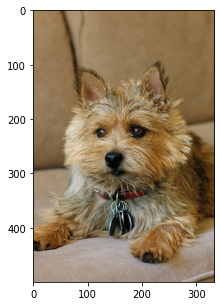

Prediction Norwich terrier
CORRECT

Ground truth Silky terrier


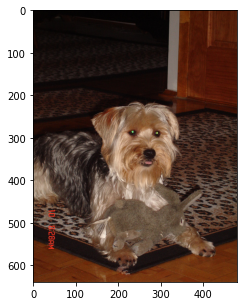

Prediction Havanese
MISSED

Ground truth Beauceron


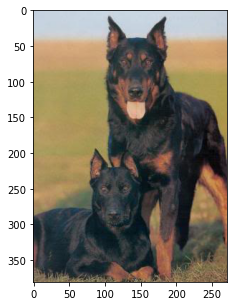

Prediction Beauceron
CORRECT

Ground truth Pembroke welsh corgi


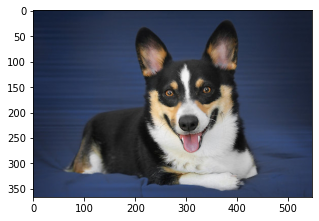

Prediction Pembroke welsh corgi
CORRECT

Ground truth Alaskan malamute


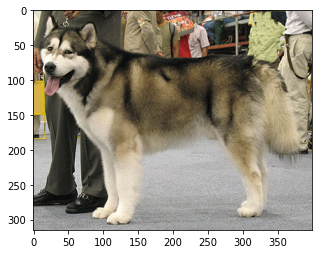

Prediction Alaskan malamute
CORRECT

Ground truth Labrador retriever


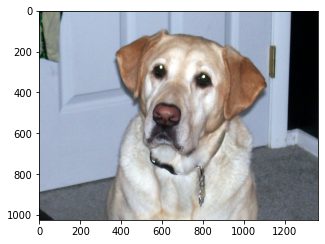

Prediction Labrador retriever
CORRECT

Ground truth Boston terrier


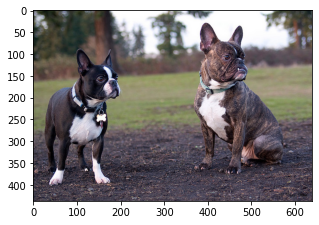

Prediction Boston terrier
CORRECT

Ground truth Leonberger


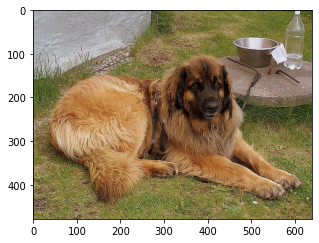

Prediction Leonberger
CORRECT

Ground truth Chow chow


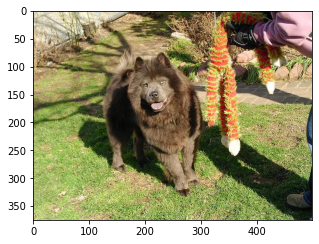

Prediction Chow chow
CORRECT

Ground truth Beagle


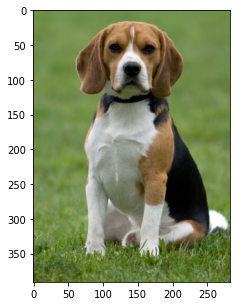

Prediction Beagle
CORRECT

Ground truth Irish wolfhound


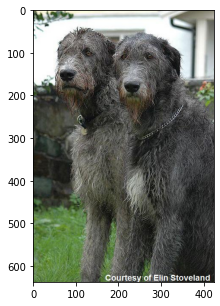

Prediction Glen of imaal terrier
MISSED

Ground truth Belgian malinois


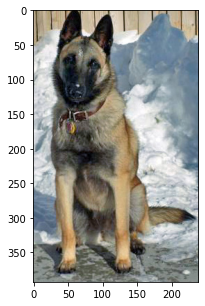

Prediction Belgian malinois
CORRECT

Ground truth French bulldog


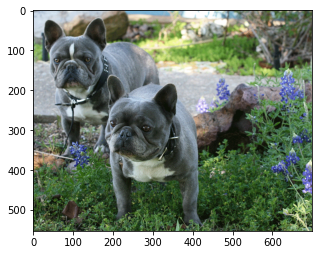

Prediction French bulldog
CORRECT

Ground truth Dachshund


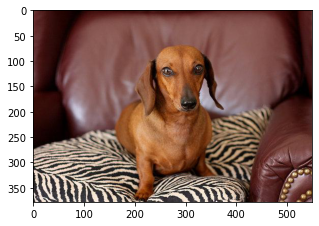

Prediction Dachshund
CORRECT

Ground truth Belgian malinois


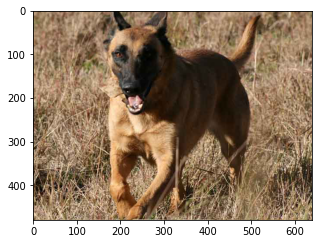

Prediction Belgian malinois
CORRECT

Ground truth Briard


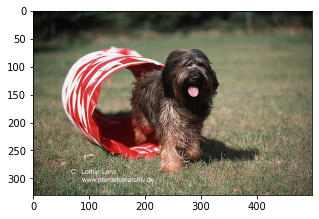

Prediction Briard
CORRECT

Ground truth Anatolian shepherd dog


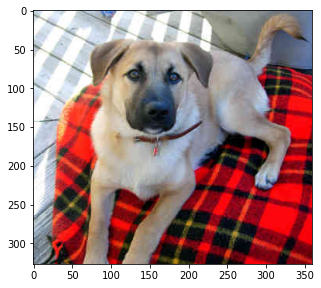

Prediction Anatolian shepherd dog
CORRECT

Ground truth German pinscher


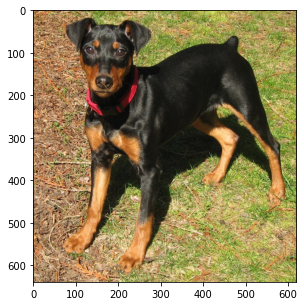

Prediction Manchester terrier
MISSED

Ground truth Basenji


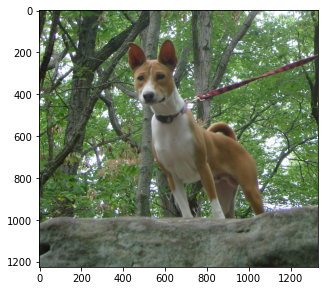

Prediction Basenji
CORRECT

Ground truth American staffordshire terrier


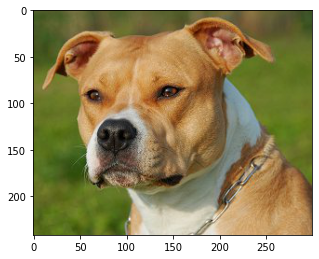

Prediction American staffordshire terrier
CORRECT

Ground truth Dandie dinmont terrier


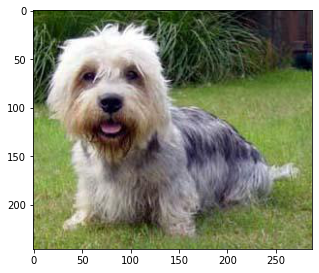

Prediction Dandie dinmont terrier
CORRECT

Ground truth German pinscher


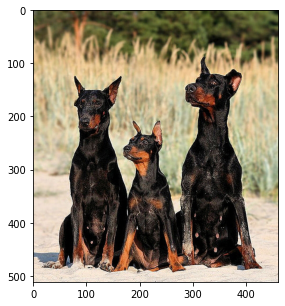

Prediction German pinscher
CORRECT

Ground truth Airedale terrier


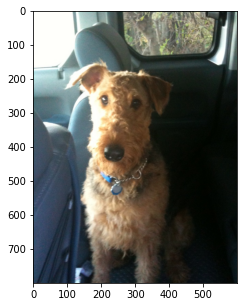

Prediction Airedale terrier
CORRECT

Ground truth Italian greyhound


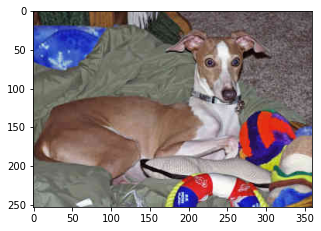

Prediction Italian greyhound
CORRECT

Ground truth Gordon setter


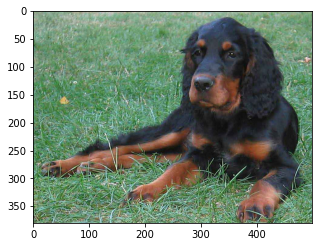

Prediction Gordon setter
CORRECT

Ground truth Icelandic sheepdog


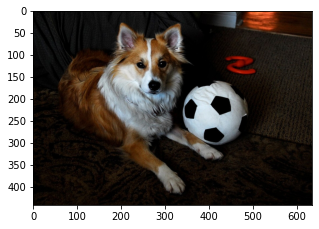

Prediction Pembroke welsh corgi
MISSED

Ground truth German wirehaired pointer


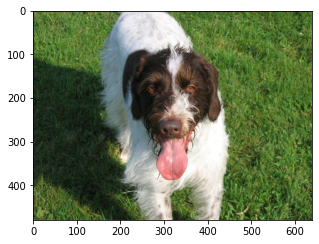

Prediction English springer spaniel
MISSED

Ground truth Pembroke welsh corgi


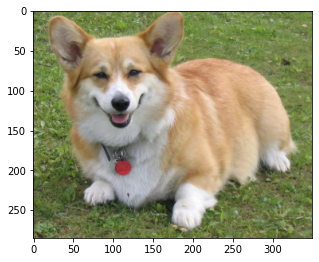

Prediction Pembroke welsh corgi
CORRECT

Ground truth Lowchen


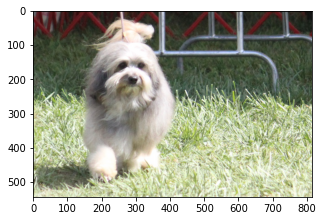

Prediction Lhasa apso
MISSED

Ground truth Clumber spaniel


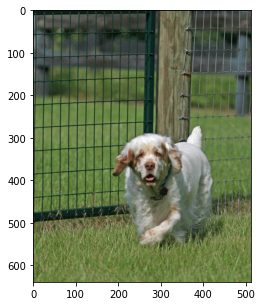

Prediction Clumber spaniel
CORRECT

Ground truth Chesapeake bay retriever


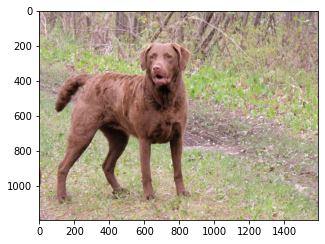

Prediction Chesapeake bay retriever
CORRECT

Ground truth Entlebucher mountain dog


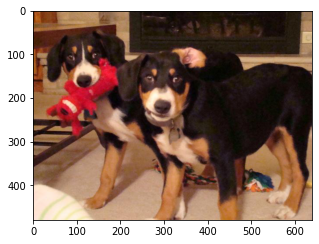

Prediction Entlebucher mountain dog
CORRECT

Ground truth Irish wolfhound


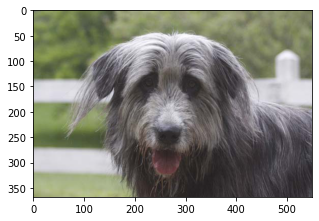

Prediction Bearded collie
MISSED

Ground truth Irish wolfhound


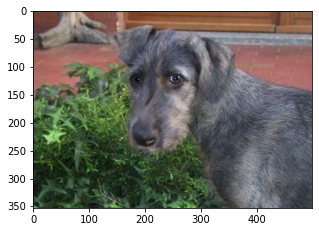

Prediction Irish wolfhound
CORRECT

Ground truth Bedlington terrier


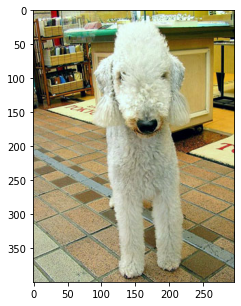

Prediction Bedlington terrier
CORRECT

Ground truth Great dane


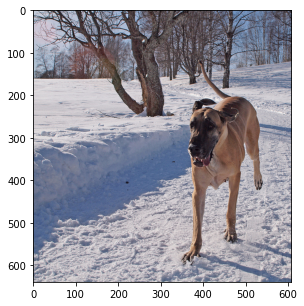

Prediction Great dane
CORRECT

Ground truth Borzoi


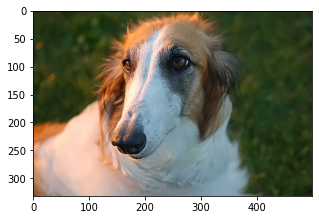

Prediction Borzoi
CORRECT

Ground truth Bouvier des flandres


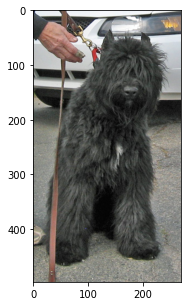

Prediction Bouvier des flandres
CORRECT

Ground truth Belgian sheepdog


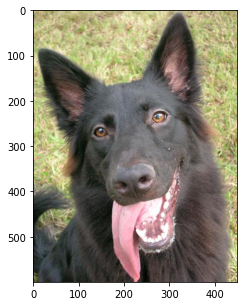

Prediction Belgian sheepdog
CORRECT

Ground truth Brittany


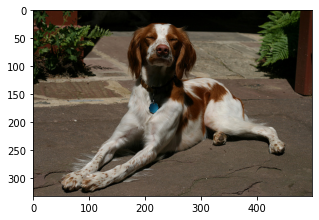

Prediction Brittany
CORRECT

Ground truth English cocker spaniel


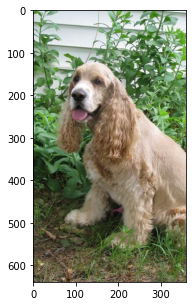

Prediction Cocker spaniel
MISSED

Ground truth Akita


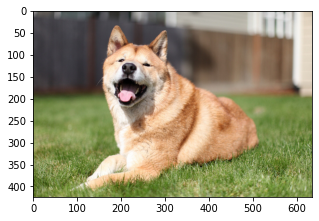

Prediction Akita
CORRECT

Ground truth Pointer


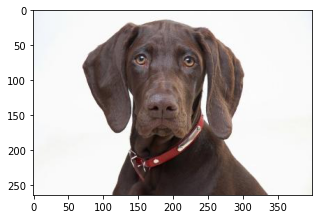

Prediction German shorthaired pointer
MISSED

Ground truth English setter


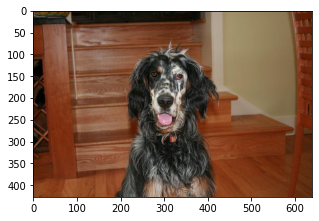

Prediction English setter
CORRECT

Ground truth French bulldog


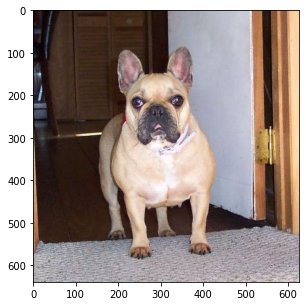

Prediction French bulldog
CORRECT

Ground truth Afghan hound


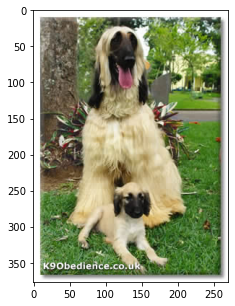

Prediction Afghan hound
CORRECT

Ground truth Chow chow


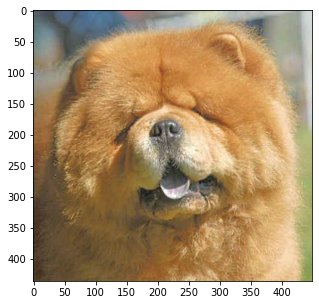

Prediction Chow chow
CORRECT

Ground truth Pharaoh hound


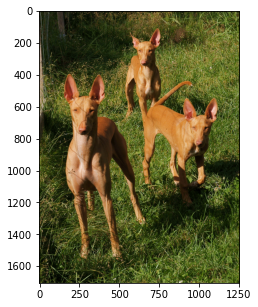

Prediction Pharaoh hound
CORRECT

Ground truth Papillon


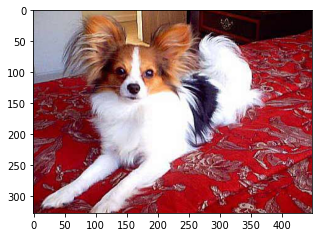

Prediction Papillon
CORRECT

Ground truth Basenji


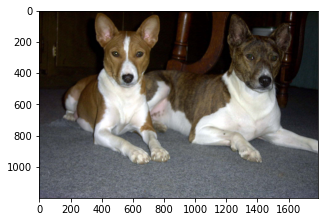

Prediction Basenji
CORRECT

Ground truth Basset hound


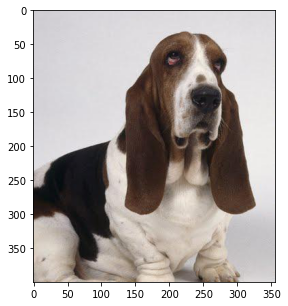

Prediction Basset hound
CORRECT

Ground truth German shorthaired pointer


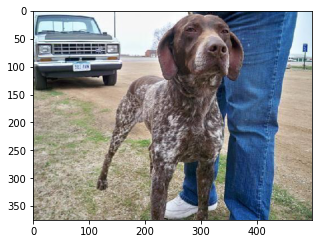

Prediction German shorthaired pointer
CORRECT

Ground truth German shepherd dog


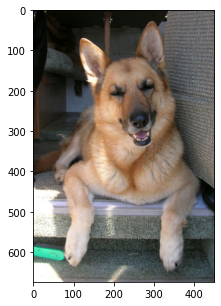

Prediction German shepherd dog
CORRECT

Ground truth Bernese mountain dog


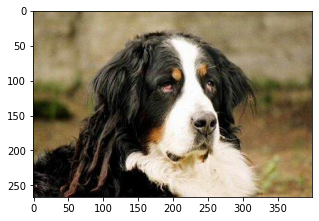

Prediction Bernese mountain dog
CORRECT

Ground truth Cane corso


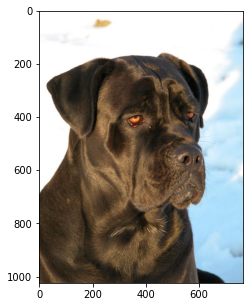

Prediction Cane corso
CORRECT

Ground truth Gordon setter


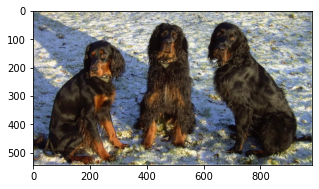

Prediction Gordon setter
CORRECT

Ground truth Bouvier des flandres


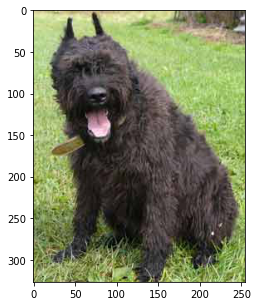

Prediction Bouvier des flandres
CORRECT

Ground truth Labrador retriever


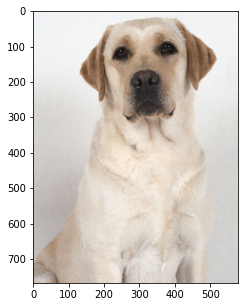

Prediction Labrador retriever
CORRECT

Ground truth Golden retriever


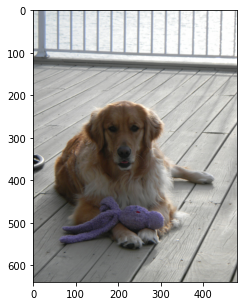

Prediction Golden retriever
CORRECT

Ground truth Saint bernard


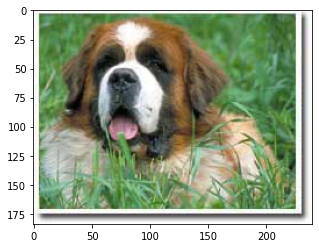

Prediction Saint bernard
CORRECT

Ground truth Cane corso


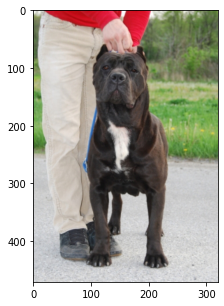

Prediction Cane corso
CORRECT

Ground truth Bedlington terrier


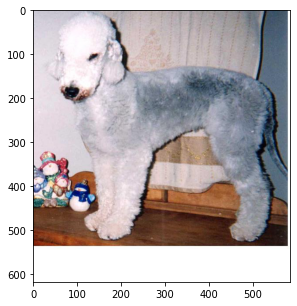

Prediction Bedlington terrier
CORRECT

Ground truth Norfolk terrier


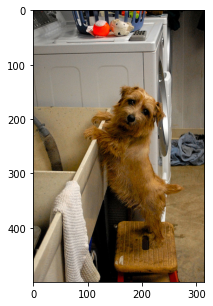

Prediction Norfolk terrier
CORRECT

Ground truth Bulldog


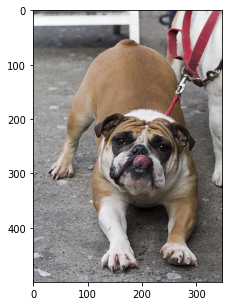

Prediction Bulldog
CORRECT

Ground truth Cocker spaniel


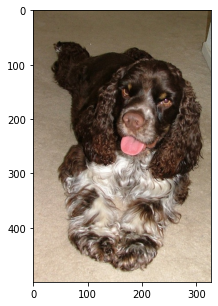

Prediction Cocker spaniel
CORRECT

Ground truth Boston terrier


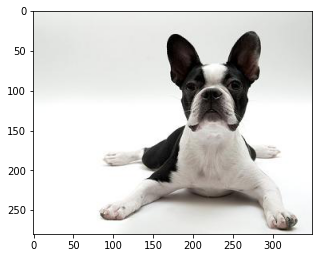

Prediction Boston terrier
CORRECT

Ground truth English springer spaniel


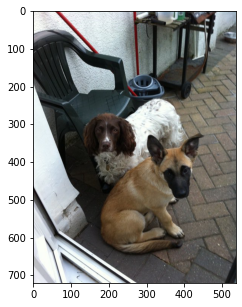

Prediction Belgian malinois
MISSED

Ground truth Dandie dinmont terrier


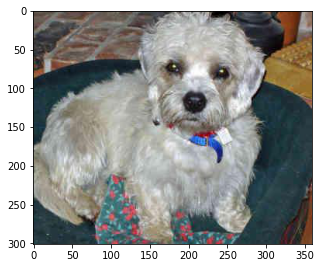

Prediction Dandie dinmont terrier
CORRECT

Ground truth Belgian tervuren


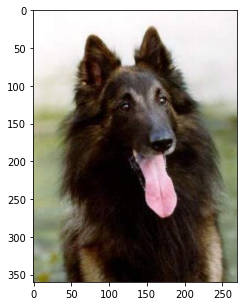

Prediction Belgian tervuren
CORRECT

Ground truth Nova scotia duck tolling retriever


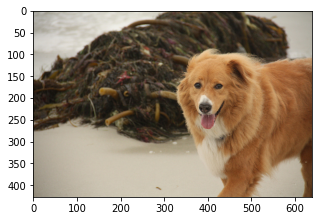

Prediction Nova scotia duck tolling retriever
CORRECT

Ground truth Cavalier king charles spaniel


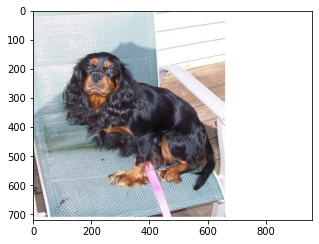

Prediction Gordon setter
MISSED

Ground truth Leonberger


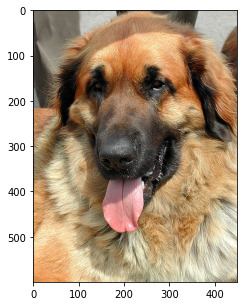

Prediction Leonberger
CORRECT

Ground truth Akita


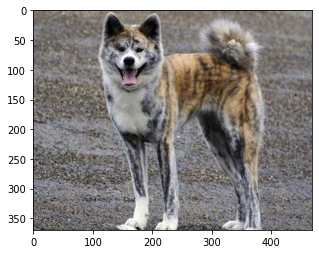

Prediction Akita
CORRECT

Ground truth Dogue de bordeaux


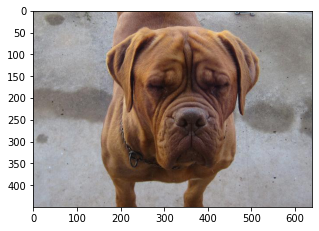

Prediction Dogue de bordeaux
CORRECT

Ground truth Border terrier


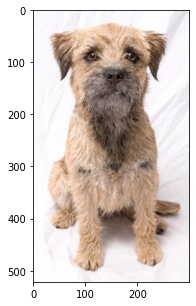

Prediction Border terrier
CORRECT

Ground truth Black russian terrier


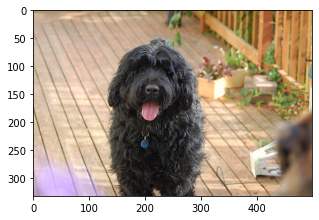

Prediction Black russian terrier
CORRECT

Ground truth American eskimo dog


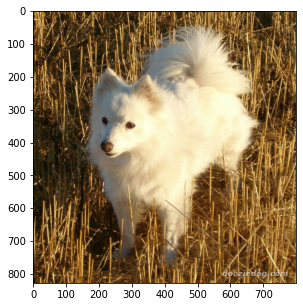

Prediction American eskimo dog
CORRECT

Ground truth Chow chow


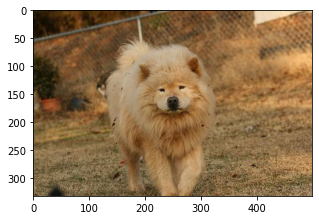

Prediction Chow chow
CORRECT

Ground truth Dogue de bordeaux


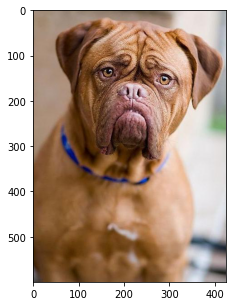

Prediction Dogue de bordeaux
CORRECT

Ground truth Silky terrier


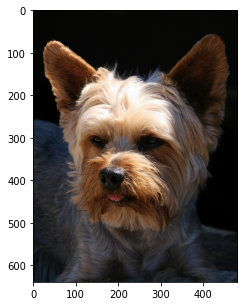

Prediction Silky terrier
CORRECT

Ground truth Keeshond


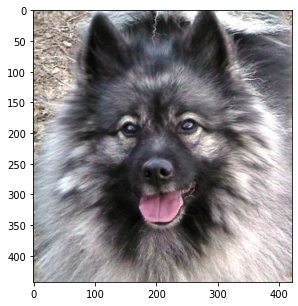

Prediction Keeshond
CORRECT

Ground truth Irish setter


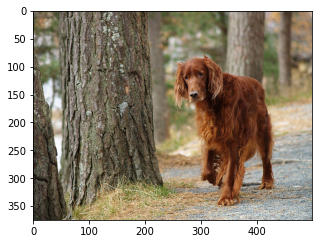

Prediction Irish setter
CORRECT

Ground truth Dachshund


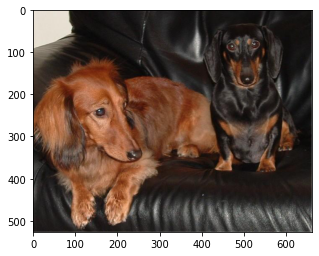

Prediction Dachshund
CORRECT

Ground truth Irish terrier


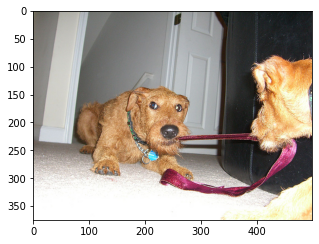

Prediction Irish terrier
CORRECT

Ground truth American eskimo dog


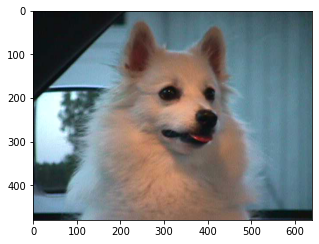

Prediction Pomeranian
MISSED

Ground truth Irish terrier


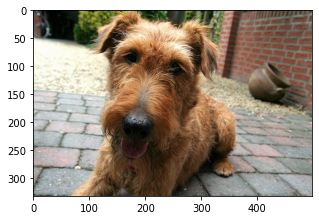

Prediction Irish terrier
CORRECT

Ground truth English springer spaniel


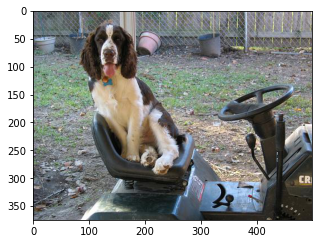

Prediction English springer spaniel
CORRECT

Ground truth Lhasa apso


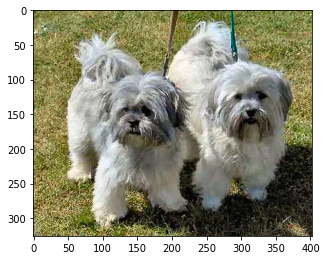

Prediction Lhasa apso
CORRECT

Ground truth Basenji


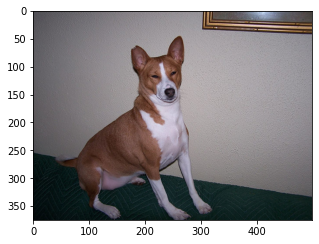

Prediction Basenji
CORRECT

Ground truth Bedlington terrier


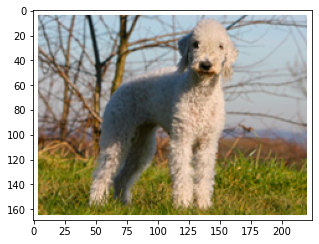

Prediction Bedlington terrier
CORRECT

Ground truth Irish wolfhound


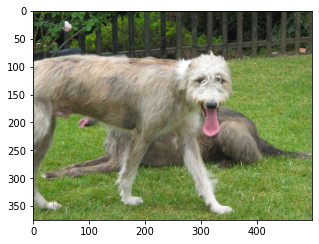

Prediction Irish wolfhound
CORRECT

Ground truth Pharaoh hound


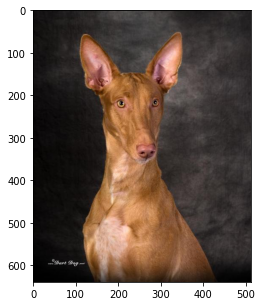

Prediction Pharaoh hound
CORRECT

Ground truth Newfoundland


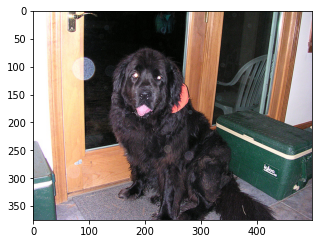

Prediction Newfoundland
CORRECT

Ground truth Belgian malinois


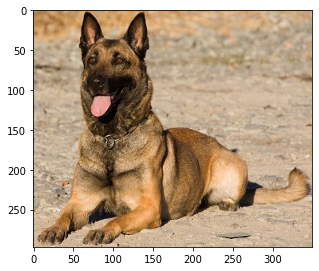

Prediction Belgian malinois
CORRECT

Correct results: 87.00% (87 out of 100)


In [129]:
all_count = 0
correct_count = 0
missed_count = 0
for fn in dog_files_short[:100]:
    img = Image.open(fn)
    label = fn.split('/')[-1].split('.')[0][:-6].replace('_', ' ')
    print('Ground truth', label)
    plt.imshow(np.asarray(img))
    plt.show()
    pred = predict_breed_transfer(fn)
    print('Prediction', pred)
    all_count += 1
    if label == pred:
        print('CORRECT')
        correct_count += 1
    else:
        print('MISSED')
        missed_count += 1
    print()
    #break

print("Correct results: {:4.2%} ({} out of {})".format(correct_count/all_count, correct_count, all_count))


# 끝

In [ ]:
print(dog_files_short)

['/content/my_dogs/Irish_red_and_white_setter_05772.jpg'
 '/content/my_dogs/Ibizan_hound_05688.jpg'
 '/content/my_dogs/Welsh_springer_spaniel_08227.jpg'
 '/content/my_dogs/Brittany_02591.jpg'
 '/content/my_dogs/Cocker_spaniel_03740.jpg'
 '/content/my_dogs/Borzoi_02203.jpg' '/content/my_dogs/Boxer_02371.jpg'
 '/content/my_dogs/Poodle_07923.jpg'
 '/content/my_dogs/Smooth_fox_terrier_08128.jpg'
 '/content/my_dogs/Boykin_spaniel_02484.jpg'
 '/content/my_dogs/French_bulldog_04816.jpg'
 '/content/my_dogs/Tibetan_mastiff_08158.jpg'
 '/content/my_dogs/Cavalier_king_charles_spaniel_03291.jpg'
 '/content/my_dogs/Bloodhound_01923.jpg'
 '/content/my_dogs/Chow_chow_03637.jpg'
 '/content/my_dogs/Pharaoh_hound_07724.jpg'
 '/content/my_dogs/Dandie_dinmont_terrier_04131.jpg'
 '/content/my_dogs/Mastiff_06847.jpg'
 '/content/my_dogs/Chesapeake_bay_retriever_03395.jpg'
 '/content/my_dogs/Akita_00282.jpg'
 '/content/my_dogs/Belgian_malinois_01452.jpg'
 '/content/my_dogs/Bichon_frise_01757.jpg'
 '/content/m

In [ ]:
!ls dogImages

test  train  valid


In [ ]:
!wget http://vision.stanford.edu/aditya86/ImageNetDogs/images.tar

--2021-08-22 02:58:46--  http://vision.stanford.edu/aditya86/ImageNetDogs/images.tar
Resolving vision.stanford.edu (vision.stanford.edu)... 171.64.68.10
Connecting to vision.stanford.edu (vision.stanford.edu)|171.64.68.10|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 793579520 (757M) [application/x-tar]
Saving to: ‘images.tar’

images.tar          100%[===================>] 756.82M  5.30MB/s    in 72s     

2021-08-22 02:59:58 (10.5 MB/s) - ‘images.tar’ saved [793579520/793579520]



In [ ]:
!wget http://vision.stanford.edu/aditya86/ImageNetDogs/annotation.tar

--2021-08-22 03:00:21--  http://vision.stanford.edu/aditya86/ImageNetDogs/annotation.tar
Resolving vision.stanford.edu (vision.stanford.edu)... 171.64.68.10
Connecting to vision.stanford.edu (vision.stanford.edu)|171.64.68.10|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 21852160 (21M) [application/x-tar]
Saving to: ‘annotation.tar’

annotation.tar      100%[===================>]  20.84M  6.01MB/s    in 4.3s    

2021-08-22 03:00:26 (4.83 MB/s) - ‘annotation.tar’ saved [21852160/21852160]



In [ ]:
!ls

annotation.tar	dogImages.zip  model_transfer.pt  sample_data
dogImages	images.tar     my_dogs


In [ ]:
!tar xf images.tar

In [ ]:
!tar xf annotation.tar

In [ ]:
!ls

Annotation	dogImages      Images	   model_transfer.pt  sample_data
annotation.tar	dogImages.zip  images.tar  my_dogs


In [ ]:
!ls Images/n02085620-Chihuahua

n02085620_10074.jpg  n02085620_1862.jpg  n02085620_3593.jpg  n02085620_5312.jpg
n02085620_10131.jpg  n02085620_1916.jpg  n02085620_3651.jpg  n02085620_5496.jpg
n02085620_10621.jpg  n02085620_199.jpg	 n02085620_3677.jpg  n02085620_5661.jpg
n02085620_1073.jpg   n02085620_2053.jpg  n02085620_3681.jpg  n02085620_5713.jpg
n02085620_10976.jpg  n02085620_2188.jpg  n02085620_368.jpg   n02085620_574.jpg
n02085620_11140.jpg  n02085620_2204.jpg  n02085620_3742.jpg  n02085620_575.jpg
n02085620_11238.jpg  n02085620_2208.jpg  n02085620_3763.jpg  n02085620_5771.jpg
n02085620_11258.jpg  n02085620_242.jpg	 n02085620_3826.jpg  n02085620_588.jpg
n02085620_11337.jpg  n02085620_2479.jpg  n02085620_382.jpg   n02085620_5927.jpg
n02085620_11477.jpg  n02085620_2507.jpg  n02085620_3838.jpg  n02085620_6295.jpg
n02085620_1152.jpg   n02085620_2517.jpg  n02085620_3875.jpg  n02085620_6399.jpg
n02085620_11696.jpg  n02085620_2590.jpg  n02085620_3877.jpg  n02085620_6931.jpg
n02085620_11818.jpg  n02085620_2614.jpg  n020

In [ ]:
### TODO: Write a function that takes a path to an image as input
### and returns the dog breed that is predicted by the model.
stanford_image_dirs = glob("/content/Images/*")
print(stanford_image_dirs)


['/content/Images/n02107574-Greater_Swiss_Mountain_dog', '/content/Images/n02097298-Scotch_terrier', '/content/Images/n02108089-boxer', '/content/Images/n02086646-Blenheim_spaniel', '/content/Images/n02091635-otterhound', '/content/Images/n02099267-flat-coated_retriever', '/content/Images/n02090622-borzoi', '/content/Images/n02110185-Siberian_husky', '/content/Images/n02097658-silky_terrier', '/content/Images/n02091244-Ibizan_hound', '/content/Images/n02096051-Airedale', '/content/Images/n02101006-Gordon_setter', '/content/Images/n02102318-cocker_spaniel', '/content/Images/n02112706-Brabancon_griffon', '/content/Images/n02099601-golden_retriever', '/content/Images/n02109047-Great_Dane', '/content/Images/n02113799-standard_poodle', '/content/Images/n02096294-Australian_terrier', '/content/Images/n02090379-redbone', '/content/Images/n02111500-Great_Pyrenees', '/content/Images/n02107312-miniature_pinscher', '/content/Images/n02113624-toy_poodle', '/content/Images/n02095570-Lakeland_terrie

In [ ]:
class_names = [item[4:].replace("_", " ") for item in data_transfer['train'].dataset.classes]

In [ ]:
class_names

['Affenpinscher',
 'Afghan hound',
 'Airedale terrier',
 'Akita',
 'Alaskan malamute',
 'American eskimo dog',
 'American foxhound',
 'American staffordshire terrier',
 'American water spaniel',
 'Anatolian shepherd dog',
 'Australian cattle dog',
 'Australian shepherd',
 'Australian terrier',
 'Basenji',
 'Basset hound',
 'Beagle',
 'Bearded collie',
 'Beauceron',
 'Bedlington terrier',
 'Belgian malinois',
 'Belgian sheepdog',
 'Belgian tervuren',
 'Bernese mountain dog',
 'Bichon frise',
 'Black and tan coonhound',
 'Black russian terrier',
 'Bloodhound',
 'Bluetick coonhound',
 'Border collie',
 'Border terrier',
 'Borzoi',
 'Boston terrier',
 'Bouvier des flandres',
 'Boxer',
 'Boykin spaniel',
 'Briard',
 'Brittany',
 'Brussels griffon',
 'Bull terrier',
 'Bulldog',
 'Bullmastiff',
 'Cairn terrier',
 'Canaan dog',
 'Cane corso',
 'Cardigan welsh corgi',
 'Cavalier king charles spaniel',
 'Chesapeake bay retriever',
 'Chihuahua',
 'Chinese crested',
 'Chinese shar-pei',
 'Chow cho

In [ ]:
dog_files_short = np.array([glob(dir + '/*')[0] for dir in stanford_image_dirs])

In [ ]:
dog_files_short

array(['/content/Images/n02107574-Greater_Swiss_Mountain_dog/n02107574_481.jpg',
       '/content/Images/n02097298-Scotch_terrier/n02097298_4701.jpg',
       '/content/Images/n02108089-boxer/n02108089_1575.jpg',
       '/content/Images/n02086646-Blenheim_spaniel/n02086646_1845.jpg',
       '/content/Images/n02091635-otterhound/n02091635_3393.jpg',
       '/content/Images/n02099267-flat-coated_retriever/n02099267_1753.jpg',
       '/content/Images/n02090622-borzoi/n02090622_5885.jpg',
       '/content/Images/n02110185-Siberian_husky/n02110185_4294.jpg',
       '/content/Images/n02097658-silky_terrier/n02097658_6017.jpg',
       '/content/Images/n02091244-Ibizan_hound/n02091244_746.jpg',
       '/content/Images/n02096051-Airedale/n02096051_7647.jpg',
       '/content/Images/n02101006-Gordon_setter/n02101006_1934.jpg',
       '/content/Images/n02102318-cocker_spaniel/n02102318_11581.jpg',
       '/content/Images/n02112706-Brabancon_griffon/n02112706_204.jpg',
       '/content/Images/n0209

In [ ]:
dog_files_short = np.array(glob("/content/Images/n02085620-Chihuahua/*"))
# list of class names by index, i.e. a name can be accessed like class_names[0]
class_names = [item[4:].replace("_", " ") for item in data_transfer['train'].dataset.classes]



In [ ]:
dog_files_short

array(['/content/Images/n02085620-Chihuahua/n02085620_326.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_2650.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_1346.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_11948.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_4290.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_8636.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_7436.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_3208.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_2921.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_1816.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_8637.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_8558.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_1558.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_1152.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_13964.jpg',
       '/content/Images/

In [ ]:
model_transfer.load_state_dict(torch.load('model_transfer.pt'))
def predict_breed_transfer(img_path):
    # load the image and return the predicted breed
    
    transform = transforms.Compose([transforms.Resize(255),
                               transforms.CenterCrop(224),
                               transforms.ToTensor(),
                                       transforms.Normalize([0.485, 0.456, 0.406], 
                                                            [0.229, 0.224, 0.225])])
    img = Image.open(img_path)
    img = transform(img)[:3,:,:].unsqueeze(0)
    if use_cuda:
        img = img.cuda()
        model_transfer.to('cuda')
        # forward pass: compute predicted outputs by passing inputs to the model
    model_transfer.eval()
    idx = torch.argmax(model_transfer(img))
    return class_names[idx]


    output = model_transfer(img)
    # convert output probabilities to predicted class
    pred = output.data.max(1, keepdim=True)[1]
    # compare predictions to true label
    return pred


In [ ]:
from matplotlib import pyplot as plt

In [ ]:
from matplotlib.pyplot import imshow
#%matplotlib inline
#pil_im = Image.open('data/empire.jpg', 'r')
#imshow(np.asarray(pil_im))

# OpenCV로 이미지 보기

In [ ]:
import cv2 as cv

In [ ]:
img2 = cv.imread(dog_files_short[0], cv.COLOR_BGR2RGB)
img = cv.imread(dog_files_short[0])

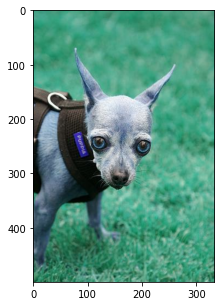

In [ ]:
plt.imshow(img)

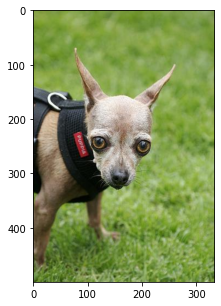

In [ ]:
fix_img = cv.cvtColor(img, cv.COLOR_BGR2RGB)
plt.imshow(fix_img)

# PIL로 이미지 보기

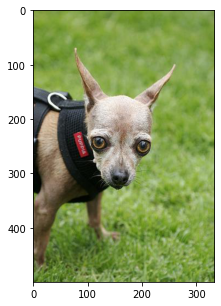

In [ ]:
from PIL import Image
image = Image.open(dog_files_short[0])
imshow(np.asarray(image))

/content/Images/n02085620-Chihuahua/n02085620_326.jpg


TypeError: ignored

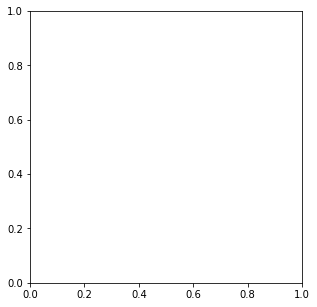

In [ ]:
for fn in dog_files_short[:3]:
    print(fn)
    plt.imshow(fn)
    print(predict_breed_transfer(fn))
    #break



In [ ]:
dog_files_short

array(['/content/Images/n02085620-Chihuahua/n02085620_326.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_2650.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_1346.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_11948.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_4290.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_8636.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_7436.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_3208.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_2921.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_1816.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_8637.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_8558.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_1558.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_1152.jpg',
       '/content/Images/n02085620-Chihuahua/n02085620_13964.jpg',
       '/content/Images/